In [5]:
## https://github.com/process-intelligence-solutions/pm4py/blob/release/notebooks/3_process_discovery.ipynb

In [6]:
import uuid
from IPython.display import display, HTML

def create_hide_button():
    unique_id = str(uuid.uuid4())
    display(HTML('''
        <script>
        function toggle_output(button_id) {
            var output_area = document.getElementById(button_id).parentElement.parentElement.nextElementSibling;
            var button = document.getElementById(button_id);
            if (output_area.style.display === "none") {
                output_area.style.display = "block";
                button.innerHTML = "Hide Output";
            } else {
                output_area.style.display = "none";
                button.innerHTML = "Show Output";
            }
        }
        </script>
    '''))

    button_id = f"button_{unique_id}"
    display(HTML(f'''
        <button id="{button_id}" onclick="toggle_output('{button_id}')">Show Output</button>
        <script>
            document.getElementById('{button_id}').parentElement.parentElement.nextElementSibling.style.display = 'none';
        </script>
    '''))

In [7]:
from IPython.display import display, HTML

display(HTML('''<style>
    .jp-CodeCell .jp-InputArea {display: none;} /* Hide only code cells */
</style>'''))

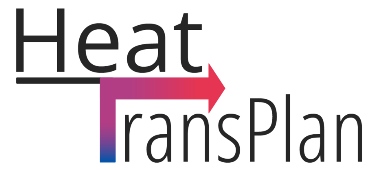


<div style="text-align: center; font-size: 50px;">
    <b>Exploratory Data Analysis</b>
</div>

In [9]:
import sys
sys.path.append('../../../')

import pandas as pd
import random
import itertools
import os
import numpy as np
from datetime import datetime, timedelta
RANDOM_SEED = 42
random.seed(RANDOM_SEED)

import simpy
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import chardet
import plotly.io as pio
import chardet#
import pandas as pd

from pathlib import Path

pio.renderers.default='notebook'
pd.options.mode.chained_assignment = None

import warnings
warnings.simplefilter("ignore", UserWarning)



In [ ]:
# Format of the Variables

In [11]:
# import os

# # Get the current working directory
# current_working_directory = os.getcwd()

# # Traverse up the directory tree until you reach the base project directory
# base_project_name = "heattransplan"
# base_path = current_working_directory

# while os.path.basename(base_path) != base_project_name:
#     base_path = os.path.dirname(base_path)
#     if base_path == "/":  # Stop if we reach the root directory
#         raise Exception(f"Base project directory '{base_project_name}' not found.")

# #print(base_path)

In [12]:
import pandas as pd
import chardet

def process_file(file_path):
    # Detect file encoding
    with open(file_path, "rb") as f:
        result = chardet.detect(f.read())
        #print(f"Detected encoding for {file_path}: {result}")

    # Read the CSV file
    df = pd.read_csv(file_path, sep=';', decimal=",", encoding=result['encoding'], low_memory=False)

    # Rename columns
    first_date_column = df.columns[0]
    df = df.rename(columns={first_date_column: "datetime"})

    # Identify columns to drop
    columns_to_drop = [col for i, col in enumerate(df.columns) if "time" in col.lower() and i != 0]  # Keep the first column containing "time"
    df = df.drop(columns=columns_to_drop)

    # Rename columns
    df = df.rename(columns=lambda x: x.replace("ValueY", "").replace(".", "").replace(" ", "_").lower())

    df['datetime'] = pd.to_datetime(df['datetime'], format='%d.%m.%Y %H:%M:%S')

    

    # Display information about the file
    # print(f"File name: {file_path}")
    # print(f"File shape: {df.shape}")
    # print(f"File columns: {df.columns}")
    # print("File head:")
    # display(df.head(5))
    # print("File tail:")
    # display(df.tail(5))
    # display(df.info())

    return df

In [16]:
# Define the path to the current file's location
current_path = Path(__file__).resolve().parent if '__file__' in globals() else Path().resolve()

# Navigate to the 'data/bronze/aixit' folder relative to the current path
base_path = current_path.parent.parent.parent / 'data' / 'bronze' / 'company_2'

base_path 

PosixPath('/Users/davidzapata/Documents/GitHub/process_energy_demand_modelling/data/bronze/company_2')

In [17]:
# Example usage
file = '2025-02-28_08-52-15/UNIP 8+ 23(f10+f11)+19.csv'
file_path = base_path  / file

df_0 = process_file(file_path)

df_0

replace_columns = {
    '(19)_zuluft_vor_entfeuchter_': '(19)_zuluft_vor_entfeuchter_temp_c', 

    '(23_f11)_': '(23)_f11_speise_temp_c', 
    '(23_f10)_': '(23)_f10_speise_temp_c',
    '(8)__abluft_vol_m3/h_': '(8)_abluft_vol_m3/h',

}

df_0 = df_0.rename(columns=replace_columns)
#df_0

#print(df_1.info())

In [18]:
# Example usage
file = "2025-02-28_08-52-15/UNIP Turm F Nov24 neu.csv"
file_path = base_path / file



df = process_file(file_path)

replace_columns = {
    '(1)_schritte_prod_': '(1)_status', 
    '(2)_zuluft_g/m³_vor_entfeuchter_': '(2)_zuluft_vor_entfeuchter_kon_g/kg', 
    '(3)_zuluft_g/m³_nach_entfeuchter_': '(3)_zuluft_nach_entfeuchter_kon_g/kg', 
    '(4)_frostschutz_': '(4)_frostschutz_%',
    '(5)_vor_vent_hauptzuluft_°c_': '(5)_vor_vent_hauptzuluft_temp_c',
    '(6)_nach_recu_reg_°c_': '(6)_nach_recu_reg_temp_c',
    '(7)_zuluft_turm_°c_': '(7)_zuluft_turmt_temp_c',
    '(8)_abluft_vol_m³/h_': '(8)_abluft_vol_m3/h_old',
    '(9)_abluft_g/m³_': '(9)_abluft2_kon_g/kg',
    '(10)_abluft_°c_': '(10)_abluft2_temp_c',
    '(11)_wm_kg/h_': '(11)_wm_mas_kg/h',
    '(12)_fb_kg/h_': '(12)_mpt_fb(mpt?)_kg/h',
    '(13)_lanzen_kg/h_': '(13)_lanzen_mas_kg/h',
    '(14)_filter_kg/h_': '(14)_filter_mas_kg/h',
    '(15)_opt_kg/h_': '(15)_filter_mas_kg/h',
    '(16)_konditionierung_kg/h_': '(16)_konditionierung_mas_kg/h',
    '(17)_zuluft_g/³m_': '(17)_zuluft_g/³m_??'
}

df_1 = df.rename(columns=replace_columns).drop(columns=['(8)_abluft_vol_m3/h_old'])

df_1= pd.merge(df_1, df_0, on='datetime', how='inner')

#df_1
#print(df_1.info())

In [19]:
# Example usage
file = "2025-02-28_08-52-15/UNIP Turm Nov Teil 2 .csv"
file_path = base_path / file

df_2 = process_file(file_path)

# replace_columns = {
#     '(1)_schritte_prod_': '(1)_status', 
#     '(2)_zuluft_g/m³_vor_entfeuchter_': '(2)_zuluft_vor_entfeuchter_kon_g/kg', 
#     '(3)_zuluft_g/m³_nach_entfeuchter_': '(3)_zuluft_nach_entfeuchter_kon_g/kg', 
#     '(4)_frostschutz_': '(4)_frostschutz_%',
#     '(5)_vor_vent_hauptzuluft_°c_': '(5)_vor_vent_hauptzuluft_temp_c',
#     '(6)_nach_recu_reg_°c_': '(6)_nach_recu_reg_temp_c',
#     '(7)_zuluft_turm_°c_': '(7)_zuluft_turmt_temp_c',
#     '(8)_abluft_vol_m³/h_': '(8)_abluft_vol_m3/h',
#     '(9)_abluft_g/m³_': '(9)_abluft2_kon_g/kg',
#     '(10)_abluft_°c_': '(10)_abluft2_temp_c',
#     '(11)_wm_kg/h_': '(11)_wm_mas_kg/h',
#     '(12)_fb_kg/h_': '(12)_mpt_fb(mpt?)_kg/h',
#     '(13)_lanzen_kg/h_': '(13)_lanzen_mas_kg/h',
#     '(14)_filter_kg/h_': '(14)_filter_mas_kg/h',
#     '(15)_opt_kg/h_': '(15)_filter_mas_kg/h',
#     '(16)_konditionierung_kg/h_': '(16)_konditionierung_mas_kg/h',
#     '(17)_zuluft_g/³m_': '(17)_zuluft_g/³m_??'
# }

# df_1 = df.rename(columns=replace_columns)
#df_2

In [22]:
# Import the legend

pd.set_option('display.max_rows', 10)


file = "2025-02-28_08-52-15/legende_turm.csv"
file_path = base_path / file
# Read the CSV file
df_legend = pd.read_csv(file_path, sep=';', decimal=".")#, encoding=result['encoding'])

df_legend.columns = ['id_original', 'id', 'status_name']

#print(df_legend.info())
pd.set_option('display.max_rows', 20)
#display(df_legend)

In [23]:
file = "2025-02-28_08-52-15/Dampf_Turm_E_Tabellarische Auswertung.xlsx"
file_path = base_path / file



df = pd.read_excel(file_path, sheet_name='Leistung  kW  (Turm F Lufterhit')#, skiprows=1)

df = df.drop(columns=['Leistung [kW] (Turm F Luftentfeuchter Dampf)\nQualitätsmerkmal', 'Leistung [kW] (Turm F Lufterhitzer Dampf)\nQualitätsmerkmal'])

replace_columns = {'Zeitstempel': 'datetime', 
                    'Leistung [kW] (Turm F Luftentfeuchter Dampf)\nSpitzenlast (Dampf) (kW)': '(18)_leistung_turmF_lufterhitzer_kw',
                    'Leistung [kW] (Turm F Lufterhitzer Dampf)\nSpitzenlast (Dampf) (kW)': '(17)_leistung_turmF_luftentfeuchter_kw'}


df = df.rename(columns=replace_columns)

df['datetime'] = pd.to_datetime(df['datetime'], format='%d.%m.%Y %H:%M:%S')

df_3 = df.copy()

#df_3

# display(df_3.head(10))
# display(df_3.tail(10))

## Neue Temepratur

In [25]:
# Example usage
file = "2025-02-28_08-52-15/(6) nach rec reg temp (neu).csv"
file_path = base_path / file

df_4 = process_file(file_path)
df_4.columns = ['datetime', '(6)_nach_recu_reg_temp_c']
df_4

,datetime,(6)_nach_recu_reg_temp_c
0,2024-11-03 12:34:31,59.056702
1,2024-11-03 12:34:36,59.056702
2,2024-11-03 12:34:41,59.085663
3,2024-11-03 12:34:46,59.085663
4,2024-11-03 12:34:51,58.998840
...,...,...
362875,2024-11-24 12:34:06,18.084488
362876,2024-11-24 12:34:11,17.997681
362877,2024-11-24 12:34:16,18.084488
362878,2024-11-24 12:34:21,18.084488


In [26]:
df_combined = pd.merge(df_1, df_2, on='datetime', how='left')
df_combined['(6)_nach_recu_reg_temp_c_old'] = df_combined['(6)_nach_recu_reg_temp_c']
df_combined = df_combined.drop(columns=['(6)_nach_recu_reg_temp_c'])

df_combined = pd.merge_asof(df_combined.sort_values('datetime'), df_3.sort_values('datetime'), on='datetime', direction='nearest')

df_combined = pd.merge_asof(df_combined.sort_values('datetime'), df_4.sort_values('datetime'), on='datetime', direction='nearest')
df_combined_legend_raw = pd.merge(df_combined, df_legend, left_on='(1)_status', right_on= 'id', how='left')
#df_combined_legend_raw = df_combined_legend_raw[df_combined_legend_raw.isna().any(axis=1)]
#df_combined_legend_raw = df_combined_legend_raw[['datetime', '(1)_status', 'id_original', 'id', 'status_name']].drop_duplicates().sort_values('datetime').reset_index(drop=True)
#
df_combined_legend_raw.info()
#df_combined_legend_raw

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145256 entries, 0 to 145255
Data columns (total 42 columns):
 #   Column                                  Non-Null Count   Dtype         
---  ------                                  --------------   -----         
 0   datetime                                145256 non-null  datetime64[ns]
 1   (1)_status                              145256 non-null  int64         
 2   (2)_zuluft_vor_entfeuchter_kon_g/kg     145256 non-null  float64       
 3   (3)_zuluft_nach_entfeuchter_kon_g/kg    145256 non-null  float64       
 4   (4)_frostschutz_%                       145256 non-null  float64       
 5   (5)_vor_vent_hauptzuluft_temp_c         145256 non-null  float64       
 6   (7)_zuluft_turmt_temp_c                 145256 non-null  float64       
 7   (9)_abluft2_kon_g/kg                    145256 non-null  float64       
 8   (10)_abluft2_temp_c                     145256 non-null  float64       
 9   (11)_wm_mas_kg/h                     

In [27]:

print(df_combined_legend_raw['(5)_vor_vent_hauptzuluft_temp_c'].mean() - df_combined_legend_raw['(6)_nach_recu_reg_temp_c_old'].mean())
print(df_combined_legend_raw['(6)_nach_recu_reg_temp_c'].mean() - df_combined_legend_raw['(5)_vor_vent_hauptzuluft_temp_c'].mean())

24.985979777712572
13.779638874128327


In [28]:
df = df_combined_legend_raw.copy()

df = df.rename(columns=replace_columns)

#df['(9)_abluft_feu_g/kg'] = df['abluft_feuchte_(g/m³)_']
df['(10)_abluft_temp_c'] = df['abluft_(c)_']
#, '(15)_filter_mas_kg/h'
df = df.drop(columns=['turm_schritte_', 'id', 'vor_hauptventilator_(c)_', '(10)_abluft2_temp_c', 'zuluft_turm_(c)_', 'abluft_feuchte_(g/m³)_', 'abluft_(c)_', 'fostschutz_v_', '(17)_zuluft_g/³m_??', 'abluft_(m³)_'])

#df['(8)_abluft_mas_kg/h'] = df['(8)_abluft_vol_m3/h'] * 1.2041
df['(8)_abluft_mas_kg/h'] = df['(8)_abluft_vol_m3/h'] * 0.77

df_combined_legend = df.rename(columns=replace_columns)
#df_combined_legend.info()
#df_combined_legend

In [29]:

# Assuming df_combined_legend is already define# Get the list of columns
columns = df_combined_legend.columns

# Create an empty list to store pairs of columns with identical values
identical_columns = []

# Compare each pair of columns
for i in range(len(columns)):
    for j in range(i + 1, len(columns)):
        if df_combined_legend[columns[i]].equals(df_combined_legend[columns[j]]):
            identical_columns.append((columns[i], columns[j]))

# Print the pairs of columns with identical values
#print("Columns with identical values:")
#for col_pair in identical_columns:
    #print(col_pair)

In [30]:
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
import warnings

# Suppress the specific FutureWarning
warnings.filterwarnings("ignore", category=FutureWarning, module="seaborn")

def visualize_data(df, datetime_col, hover_cols=None, viz_hover=False, library="plotly"):
    """
    Visualize each variable in a DataFrame with descriptive stats, histogram, and linechart.
    
    Parameters:
    - df: pandas DataFrame
    - datetime_col: column name for datetime values
    - hover_cols: list of column names to include in hover data (for Plotly)
    - viz_hover: boolean to determine whether to visualize hover columns
    - library: visualization library to use ('plotly' or 'seaborn')
    """
    # Ensure the datetime column is in datetime format
    df[datetime_col] = pd.to_datetime(df[datetime_col])

    # Set Seaborn theme
    sns.set_theme(style="whitegrid", context="talk")

    # Determine columns to plot
    columns_to_plot = df.columns.difference(hover_cols) if not viz_hover and hover_cols else df.columns

    for col in columns_to_plot:
        if col == datetime_col:
            continue  # Skip the datetime column

        print(f"Variable: {col}")
        desc = df[col].describe().to_frame().T  # Convert describe output to DataFrame and transpose
        desc['unique'] = df[col].nunique()  # Add unique values count to the describe output
        display(desc)

        if library == "plotly":
            # Plotly Histograms
            fig_hist = px.histogram(df, x=col, title=f"Histogram of {col}")
            fig_hist.update_layout(width=1400, height=500)
            fig_hist.show()

            # Plotly Line Chart
            fig_line = px.line(df, x=datetime_col, y=col, title=f"{col}", hover_data=hover_cols)
            fig_line.update_layout(width=1400, height=500)
            fig_line.show()

        elif library == "seaborn":
            # Seaborn Histogram
            plt.figure(figsize=(20, 6))
            sns.histplot(df[col], kde=True, bins=30, color="green", edgecolor="black")
            plt.title(f"Histogram of {col}", fontsize=16)
            plt.xlabel(col, fontsize=14)
            plt.ylabel("Frequency", fontsize=14)
            plt.show()

            # Seaborn Line Chart
            plt.figure(figsize=(20, 6))
            sns.lineplot(data=df, x=datetime_col, y=col, color="green", linewidth=2.5)
            plt.title(f"{col} Over Time", fontsize=16)
            plt.xlabel("Datetime", fontsize=14)
            plt.ylabel(col, fontsize=14)
            plt.xticks(rotation=45, fontsize=12)
            plt.yticks(fontsize=12)
            plt.tight_layout()
            plt.show()


        # Print a horizontal line
        print("\u2500" * 220)

# Example usage
# df = pd.read_csv("your_data.csv")  # Load your dataframe here
# visualize_data(df, datetime_col="your_datetime_column", hover_cols=["col1", "col2"], viz_hover=False, library="plotly")

In [21]:
# calculation
# df = df_calculations.copy()

# # Constants for l01 Magermilch
# rho = 1.036  # Density of milk in kg/dm³
# c = 3.95  # Specific heat capacity of milk in kJ/(kg·K)
# T_in = 5  # Input temperature in °C

# df = df[df['pro_volstrom_l01_l/h'] >= 0 ]
# df = df[df['pro_volstrom_l02_l/h'] >= 0 ]

# # Calculate the power required in kW
# df['pro_power_kW_l01'] = ((df['pro_volstrom_l01_l/h'] * rho) * c * (df['pro_temp_out_l01_'] - T_in))  / 3600 # Power in kJ/h to kW

# #display(df[['pro_volstrom_l01_l/h', 'pro_temp_out_l01_', 'pro_power_kW_l01']])

# # Constants for l02 Magermilch Konzentrat
# rho = 1.05  
# c = 3.8

# # Calculate the power required in kW
# df['pro_power_kW_l02'] = ((df['pro_volstrom_l02_l/h'] * rho) * c * (df['pro_temp_out_l02_'] - T_in))  / 3600 # Power in kJ/h to kW

# df[['pro_volstrom_l02_l/h', 'pro_temp_out_l02_', 'pro_power_kW_l01']]




# ################## Steam power calculation ##################
# h = 2100 # kJ/kg

# # Q (kw) = (massflow * condensation enthalpy)/ 3600
# # Calculate the power required in kW
# #df['dampfmenge_kg/h_nmb+cip_'] = (df['dampfmenge_kg/h_nmb+cip_'])#/ 1000
# df['medium_power_kW'] = (df['dampfmenge_kg/h_nmb+cip_'] * h)/ 3600

# # Steam in ton/s????

# df_calculations = df.copy()

In [22]:
# df_calculations.columns

In [23]:
# #### The variables are resampled per hour
# pd.set_option('display.max_rows', 10)

# all_columns = df_calculations.columns

# # Define columns to aggregate with 'first'
# first_columns = ['schritt_l01_', 'schritt_l02_', 'mat_id_m01_', 'mat_id_m02_', 'mat_id_m03_', 'status_name_l01', 'status_name_l02']

# # Define columns to aggregate with 'sum'
# sum_columns = ['pro_menge_l01_kg', 'pro_menge_l02_kg']

# # Define columns to aggregate with 'mean' (all others not in first_columns or sum_columns)
# mean_columns = [col for col in all_columns if col not in first_columns + sum_columns]

# # Create a dictionary for aggregation methods
# agg_dict = {col: 'mean' for col in mean_columns}
# agg_dict.update({col: 'first' for col in first_columns})
# agg_dict.update({col: 'sum' for col in sum_columns})  # Sum aggregation for specific columns

# # Resample by 5 minutes and apply custom aggregation
# df_resampled_1min = df_calculations.resample('1T', on='datetime').agg(agg_dict).reset_index(drop=True)

# #df_resampled_5_min

# Diagram

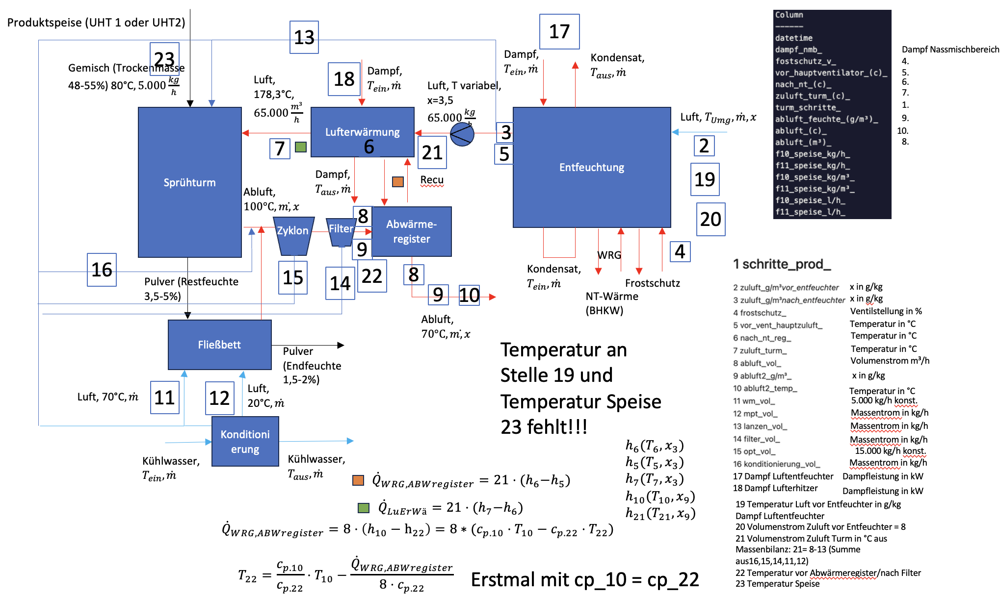

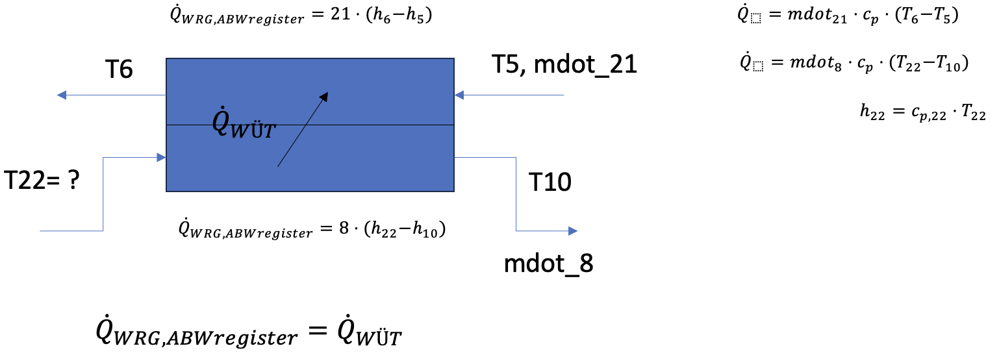

In [24]:
# Visuals

In [31]:
import pandas as pd

# Assuming df_combined_legend is already defined

# Get the list of columns
columns = df_combined_legend.columns

# Create an empty list to store pairs of columns with identical values
identical_columns = []

# Compare each pair of columns
for i in range(len(columns)):
    for j in range(i + 1, len(columns)):
        if df_combined_legend[columns[i]].equals(df_combined_legend[columns[j]]):
            identical_columns.append((columns[i], columns[j]))

# Print the pairs of columns with identical values
#print("Columns with identical values:")
for col_pair in identical_columns:
    print(col_pair)

In [32]:
import pandas as pd
import plotly.express as px

#relevant_columns = ['datetime', 'dampfmenge_kg/h_nmb+cip_', 'medium_power_kW', 'pro_power_kW_l01', 'pro_power_kW_l02']


df = df_combined_legend#[relevant_columns].copy()

# Define the date range with hours
day_start = '2024-11-16 08:00:00'
day_end = '2024-11-16 18:00:00'

# Ensure the datetime column is in datetime format
df['datetime'] = pd.to_datetime(df['datetime'])

# Filter the DataFrame for the specified date range
df= df[(df['datetime'] >= pd.to_datetime(day_start)) & 
                 (df['datetime'] < pd.to_datetime(day_end))]

# Assuming 'df' is your DataFrame
# Ensure the 'datetime' column is of type datetime
df['datetime'] = pd.to_datetime(df['datetime'])

# Exclude non-numeric columns for plotting
numeric_columns = df.select_dtypes(include=[float, int]).columns

# Create the Plotly figure
fig = px.line(df, x='datetime', y=numeric_columns,
              labels={col: col for col in numeric_columns},
              title='Interactive Visualization of Variables')

# Update layout to make columns clickable
fig.update_layout(
    xaxis_title='Datetime',
    yaxis_title='Value',
    legend_title='Variables',
    hovermode='x unified',
)

# Show the plot
fig.show()

####

- Temperatur in 6 ist niedriger als in 5

In [33]:
df = df_combined_legend

#df.columns

- [Index](#Index)

In [28]:
# Get the weather

In [29]:
# Wetterdaten vom Wetterdienst für den Standort abfragen und mit den Prozessdaten verknüpfen.

In [ ]:
# file = "weather.csv"
# file_path = base_path / file

# # Copy original DataFrame
# df = df_combined_legend.copy()

# getweather = False

# if getweather == True:
#     # Define latitude, longitude, and date range from hipp
#     latitude = 52.10873616116998
#     longitude = 8.654352922546678
#     start_date = df['datetime'].min().strftime('%Y-%m-%d')
#     end_date = df['datetime'].max().strftime('%Y-%m-%d')

#     # Fetch weather data
#     df_weather = get_weather(start_date, end_date, latitude, longitude)

#     # Save the weather data to the CSV file
#     df_weather.to_csv(file_path, index=False)
# else: 

#     # Load the data back
#     df_weather = pd.read_csv(file_path)

# # Display loaded data

# df_weather = df_weather.rename(columns={'timestamp_utc': 'datetime'})
# df_weather['datetime'] = pd.to_datetime(df_weather['datetime'])

# Calculations and aggegation per hour

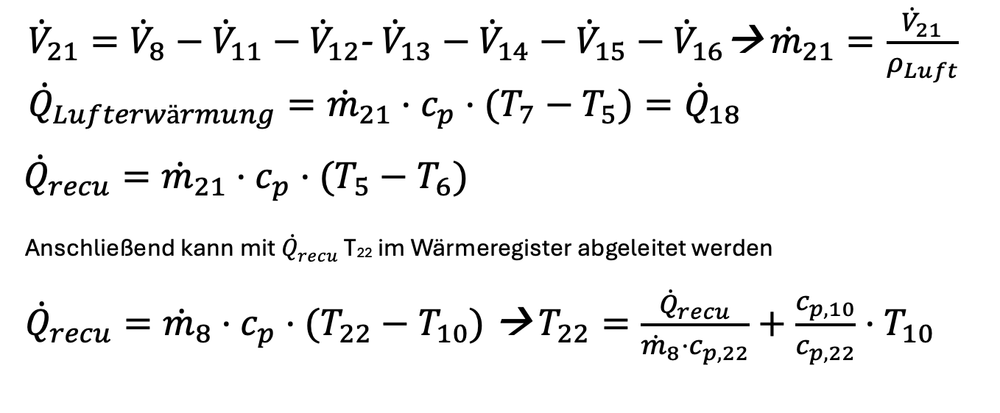

T6 und T5 tauschen, T6 hat neuen Werten

In [31]:
#df_combined_legend.columns

In [32]:
# df = df_combined_legend.copy()

# df = pd.merge_asof(df.sort_values('datetime'), df_weather.sort_values('datetime'), on='datetime', direction='nearest')

# # Calculate the mass flow rate of air in kg/h at position 21 
# df['(21)_zuluft_turm_mas_kg/h'] = df['(8)_abluft_mas_kg/h'] - (df['(13)_lanzen_mas_kg/h'] + df['(16)_konditionierung_mas_kg/h'] + df['(14)_filter_mas_kg/h'] + df['(11)_wm_mas_kg/h'] + df['(12)_mpt_fb(mpt?)_kg/h'] + df['(15)_filter_mas_kg/h'])#df['(13)_lanzen_mas_kg/h'] #- df['(16)_konditionierung_mas_kg/h'] - df['(14)_filter_mas_kg/h'] - df['(11)_wm_mas_kg/h'] - df['(12)_mpt_fb(mpt?)_kg/h'] - df['(15)_filter_mas_kg/h']

# cp_21 = 1.005 # kJ/(kg·K)

# #5 is greater than 6
# # 6 is 5?

# cp_22 = cp_10 = 1.005  

# # Calculate the heat transfer in kW from the HEX
# df['(31)_q_waerme_recu_kw'] = df['(21)_zuluft_turm_mas_kg/h'] * cp_21 * (df['(5)_vor_vent_hauptzuluft_temp_c']- df['(6)_nach_recu_reg_temp_c_old']) * 1/3600

# # Calculate the temperature at position 22 using the heat transfer equation
# df['(22)_t_waermereg_c'] = (df['(10)_abluft_temp_c'] * (cp_10/cp_22)) + (df['(31)_q_waerme_recu_kw'] /(df['(8)_abluft_mas_kg/h'] * cp_22))


# # Calculation from the real Q damp plus the heat from the recuperation. 17 ist angennomen
# df['(33)_q_lufterwearmung_dampgemessen_und_berechnete_recu_kw'] = df['(31)_q_waerme_recu_kw'] + df['(17)_leistung_turmF_luftentfeuchter_kw']

# # Calculation from the real Q damp plus the heat from the recuperation. 17 ist angennomen
# df['(34)_q_lufterwearmung_berechnet_nach_temp_in_out_kw'] = df['(21)_zuluft_turm_mas_kg/h'] * cp_21 * (df['(7)_zuluft_turmt_temp_c']- df['(5)_vor_vent_hauptzuluft_temp_c']) * 1/3600




# df_calculations = df.copy()

# print(df['(31)_q_waerme_recu_kw'].mean())

In [34]:
# Neu Berechnung

df = df_combined_legend.copy()

#df = pd.merge_asof(df.sort_values('datetime'), df_weather.sort_values('datetime'), on='datetime', direction='nearest')

# Calculate the mass flow rate of air in kg/h at position 21 
df['(21)_zuluft_turm_mas_kg/h'] = df['(8)_abluft_mas_kg/h'] - (df['(13)_lanzen_mas_kg/h'] + df['(16)_konditionierung_mas_kg/h'] + df['(14)_filter_mas_kg/h'] + df['(11)_wm_mas_kg/h'] + df['(12)_mpt_fb(mpt?)_kg/h'] + df['(15)_filter_mas_kg/h'])

cp_21 = 1.005 # kJ/(kg·K)

#5 is greater than 6
# 6 is 5?

cp_22 = cp_10 = 1.005  

# Calculate the heat transfer in kW from the HEX
df['(31)_q_waerme_recu_kw'] = df['(21)_zuluft_turm_mas_kg/h'] * cp_21 * (df['(6)_nach_recu_reg_temp_c'] - df['(5)_vor_vent_hauptzuluft_temp_c']) * 1/3600

# Calculate the temperature at position 22 using the heat transfer equation
df['(22)_t_waermereg_c'] = (df['(10)_abluft_temp_c'] * (cp_10/cp_22)) + (df['(31)_q_waerme_recu_kw'] /(df['(8)_abluft_mas_kg/h'] * cp_22))

df['(29)_q_lufterwearmung_von_T6_nach_T7_kw'] = df['(21)_zuluft_turm_mas_kg/h'] * cp_21 * (df['(7)_zuluft_turmt_temp_c'] - df['(6)_nach_recu_reg_temp_c']) * 1/3600

df['(30)_q_lufterwearmung_brechenet_T5_T6_und_T6_T7_und_berechnete_recu_kw'] = df['(29)_q_lufterwearmung_von_T6_nach_T7_kw'] + df['(31)_q_waerme_recu_kw']


# Calculation from the real Q damp plus the heat from the recuperation. 17 ist angennomen
df['(33)_q_lufterwearmung_dampgemessen_und_berechnete_recu_kw'] = df['(31)_q_waerme_recu_kw'] + df['(17)_leistung_turmF_luftentfeuchter_kw']
#df['(33)_q_lufterwearmung_dampgemessen_und_berechnete_recu_kw'] = df['(31)_q_waerme_recu_kw'] + df['(18)_leistung_turmF_lufterhitzer_kw']

# Calculation from the real Q damp plus the heat from the recuperation. 17 ist angennomen
df['(34)_q_lufterwearmung_berechnet_nach_temp_in_out_kw'] = df['(21)_zuluft_turm_mas_kg/h'] * cp_21 * (df['(7)_zuluft_turmt_temp_c']- df['(5)_vor_vent_hauptzuluft_temp_c']) * 1/3600




df_calculations = df.copy()

print(df['(31)_q_waerme_recu_kw'].mean())

98.80337420776561


In [34]:
# Aggregated Dataset per Hour

In [39]:
df_calculations

,datetime,(1)_status,(2)_zuluft_vor_entfeuchter_kon_g/kg,(3)_zuluft_nach_entfeuchter_kon_g/kg,(4)_frostschutz_%,(5)_vor_vent_hauptzuluft_temp_c,(7)_zuluft_turmt_temp_c,(9)_abluft2_kon_g/kg,(11)_wm_mas_kg/h,(12)_mpt_fb(mpt?)_kg/h,...,status_name,(10)_abluft_temp_c,(8)_abluft_mas_kg/h,(21)_zuluft_turm_mas_kg/h,(31)_q_waerme_recu_kw,(22)_t_waermereg_c,(29)_q_lufterwearmung_von_T6_nach_T7_kw,(30)_q_lufterwearmung_brechenet_T5_T6_und_T6_T7_und_berechnete_recu_kw,(33)_q_lufterwearmung_dampgemessen_und_berechnete_recu_kw,(34)_q_lufterwearmung_berechnet_nach_temp_in_out_kw
0,2024-11-03 00:00:11,0,4.049005,7.970316,15.0,32.360001,93.113434,6.619036,5000,1.446759,...,Grundstellung,31.778069,-0.280327,-15002.775987,-111.813125,428.660178,-142.638959,-254.452083,-79.759125,-254.452083
1,2024-11-03 00:00:21,0,4.049005,7.939855,15.0,32.360001,93.026611,6.614989,5000,1.446759,...,Grundstellung,31.778069,-0.272215,-15002.767875,-111.813064,440.487056,-142.275245,-254.088309,-79.759064,-254.088309
2,2024-11-03 00:00:31,0,4.049005,7.939855,15.0,32.360001,93.055542,6.635113,5000,3.616898,...,Grundstellung,31.787109,-0.287459,-15004.880919,-111.828812,418.877256,-142.416470,-254.245283,-79.774812,-254.245283
3,2024-11-03 00:00:41,0,4.049005,7.906745,15.0,32.220001,93.026611,6.658475,5000,1.446759,...,Grundstellung,31.805191,-0.287165,-15002.782825,-112.399532,421.268632,-142.275387,-254.674919,-80.345532,-254.674919
4,2024-11-03 00:00:51,0,4.049005,7.906745,15.0,32.220001,93.055542,6.630729,5000,1.446759,...,Grundstellung,31.750938,-0.279676,-15002.775335,-112.399476,431.643932,-142.396486,-254.795961,-80.345476,-254.795961
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145251,2024-11-19 19:28:41,70,3.794260,2.959442,15.0,19.760002,174.971069,22.151314,5000,14545.717773,...,Produktion,65.297668,88965.836094,43387.819004,307.049599,65.301103,1572.934023,1879.983622,2253.049599,1879.983622
145252,2024-11-19 19:28:51,70,3.794260,2.959442,15.0,19.760002,174.884247,21.918381,5000,14521.123047,...,Produktion,65.270546,84902.738594,39777.594551,281.500539,65.273845,1441.088810,1722.589349,2227.500539,1722.589349
145253,2024-11-19 19:29:01,70,3.794260,2.973670,15.0,19.760002,174.971069,21.895948,5000,14555.121094,...,Produktion,65.297668,85687.025703,40586.549141,286.241837,65.300992,1472.363445,1758.605282,2232.241837,1758.605282
145254,2024-11-19 19:29:11,70,3.794260,2.973670,15.0,19.760002,174.855316,21.979092,5000,14554.398438,...,Produktion,65.297668,87715.199688,42546.868633,300.067241,65.301072,1542.103328,1842.170570,2246.067241,1842.170570


In [40]:
# Store the df



# Define the path to the current file's location
current_path = Path(__file__).resolve().parent if '__file__' in globals() else Path().resolve()

# Navigate to the 'data/bronze/aixit' folder relative to the current path
path_to_save = current_path.parent.parent.parent / 'data' / 'silver' / 'process_3'

df_calculations.to_parquet(path_to_save / "df_combined_legend.parquet", index=False)

In [ ]:
stop

In [35]:
#### The variables are resampled per hour
pd.set_option('display.max_rows', 10)

all_columns = df_calculations.columns

# Define columns to aggregate with 'first'
first_columns = ['(1)_status', 'id_original', 'status_name']

# Define columns to aggregate with 'sum'
sum_columns = []

# Define columns to aggregate with 'mean' (all others not in first_columns or sum_columns)
mean_columns = [col for col in all_columns if col not in first_columns + sum_columns]

# Create a dictionary for aggregation methods
agg_dict = {col: 'mean' for col in mean_columns}
agg_dict.update({col: 'first' for col in first_columns})
agg_dict.update({col: 'sum' for col in sum_columns})  # Sum aggregation for specific columns

# Resample by 5 minutes and apply custom aggregation
df_resampled_1_min = df_calculations.resample('15min', on='datetime').agg(agg_dict).reset_index(drop=True)

#df_resampled_1_min.isna().sum().sum()

In [36]:
# Define columns to aggregate with 'mean' (all others not in first_columns or sum_columns)
mean_columns = [col for col in all_columns if col not in first_columns + sum_columns]

# Create a dictionary for aggregation methods
agg_dict = {col: 'mean' for col in mean_columns}
agg_dict.update({col: 'first' for col in first_columns})
agg_dict.update({col: 'sum' for col in sum_columns})  # Sum aggregation for specific columns

# Resample by 5 minutes and apply custom aggregation
df_resampled_1H = df_calculations.resample('h', on='datetime').agg(agg_dict).reset_index(drop=True)

df_resampled_1H['datetime'] = pd.to_datetime(df_resampled_1H['datetime']).dt.floor('h')

#df_resampled_1H

In [37]:
df = df_resampled_1H.copy()

df['datetime'] = pd.to_datetime(df['datetime'])

# Ensure the timestamp_utc column is in datetime format
#df_weather['datetime'] = pd.to_datetime(df_weather['datetime'])

df_resampled_1H_weather = df#pd.merge(df, df_weather, 
                           #left_on='datetime', 
                           #right_on='datetime', 
                           #how='left')

#df_resampled_1H_weather.isna().sum().reset_index()

In [38]:
nan_rows = df_resampled_1H_weather[df_resampled_1H_weather.isna().any(axis=1)]
#nan_rows

In [39]:

# Get the count of missing values for each column and convert to DataFrame
missing_values_df = df_resampled_1H_weather.isna().sum().reset_index()
missing_values_df.columns = ['Variable', 'MissingValues']

# Sort the DataFrame by the number of missing values
#missing_values_df = missing_values_df.sort_values(by='MissingValues', ascending=False)

# Display the DataFrame
#missing_values_df

In [40]:
import pandas as pd
import plotly.express as px

df = df_resampled_1H_weather.copy()

#df['diff'] = df['(33)_q_lufterwearmung_calculated_kw'] - df['(31)_q_lufterwearmung_kw']

# Assuming 'df' is your DataFrame
# Ensure the 'datetime' column is of type datetime
df['datetime'] = pd.to_datetime(df['datetime'])

# Exclude non-numeric columns for plotting
numeric_columns = df.select_dtypes(include=[float, int]).columns

# Create the Plotly figure
fig = px.line(df, x='datetime', y=numeric_columns,
              labels={col: col for col in numeric_columns},
              title='Interactive Visualization of Variables')

# Update layout to make columns clickable
fig.update_layout(
    xaxis_title='Datetime',
    yaxis_title='Value',
    legend_title='Variables',
    hovermode='x unified',
)

# Show the plot
fig.show()

In [ ]:
# import pandas as pd
# import plotly.express as px

# df = df_resampled_1H_weather.copy()

# df['diff'] = df['(33)_q_lufterwearmung_calculated_kw'] - df['(31)_q_lufterwearmung_kw']

# # Assuming 'df' is your DataFrame
# # Ensure the 'datetime' column is of type datetime
# df['datetime'] = pd.to_datetime(df['datetime'])

# # Exclude non-numeric columns for plotting
# numeric_columns = df.select_dtypes(include=[float, int]).columns

# # Create the Plotly figure
# fig = px.line(df, x='datetime', y=numeric_columns,
#               labels={col: col for col in numeric_columns},
#               title='Interactive Visualization of Variables')

# # Update layout to make columns clickable
# fig.update_layout(
#     xaxis_title='Datetime',
#     yaxis_title='Value',
#     legend_title='Variables',
#     hovermode='x unified',
# )

# # Show the plot
# fig.show()

- [Index](#Index)

# Visualize the all the variables together scaling them from 0 to 1

Auf die Legende klicken, um einzelne Variablen auszuwählen.

In [ ]:
import pandas as pd
import plotly.express as px
from sklearn.preprocessing import MinMaxScaler

# Assuming 'df_resampled_1H' is your original DataFrame
df = df_resampled_1H_weather.copy()

# Select only numeric columns for scaling, excluding 'datetime'
columns_to_scale = df.select_dtypes(include=[float, int]).columns

# Scale the variables to the range [0, 1]
scaler = MinMaxScaler()
df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])

# Create the Plotly figure
fig = px.line(df, x='datetime', y=columns_to_scale,
              labels={col: col for col in columns_to_scale},
              title='Interactive Visualization of Scaled Variables',
              hover_data={'(1)_status': True, 'status_name': True})

# Update layout to make columns clickable
fig.update_layout(
    xaxis_title='Datetime',
    yaxis_title='Scaled Value',
    legend_title='Variables',
    hovermode='x unified',
)

# Show the plot
fig.show()

Fragen:


# Process Mining

In [ ]:
#df_resampled_1_min.columns

In [ ]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Assuming df_resampled_1min is already defined
process_df = df_resampled_1_min[['datetime', 'status_name']].reset_index()

# Count the number of minutes each status was activated
status_counts_l01 = process_df['status_name'].value_counts()
#status_counts_l02 = process_df['status_name_l02'].value_counts()

# Convert minutes to hours
status_counts_l01_hours = status_counts_l01 / 60
#status_counts_l02_hours = status_counts_l02 / 60

# Create the figure
fig = make_subplots(rows=1, cols=1, subplot_titles=('Minutes each status was activated'))

# Add the bar plot for status_name_l01
fig.add_trace(
    go.Bar(
        x=status_counts_l01.index, 
        y=status_counts_l01.values, 
        name='L01',
        hovertemplate='Status: %{x}<br>Minutes: %{y}<br>Hours: %{customdata:.2f}<extra></extra>',
        customdata=status_counts_l01_hours.values
    ),
    row=1, col=1
)

# Update layout
fig.update_layout(title_text="Minutes each status was activated")

# Show the plot
fig.show()

In [ ]:
# import pm4py
# import matplotlib.pyplot as plt
# from pm4py.visualization.heuristics_net import visualizer as hn_visualizer

# # Visualization for status_name
# df = df_combined_legend[['datetime', 'status_name']].reset_index()
# df['index'] = 1
# df = df[['datetime', 'status_name', 'index']]
# df.columns = ['timestamp', 'activity', 'case_id']
# df = df[df['activity'] != df['activity'].shift(-1)]
# event_log = pm4py.format_dataframe(df, case_id='case_id', activity_key='activity', timestamp_key='timestamp')
# event_log['recipe'] = 'A'
# map_ = pm4py.discover_heuristics_net(event_log)
# gviz = hn_visualizer.apply(map_)
# hn_visualizer.save(gviz, "heuristics_net.png")

# # Display the image
# fig, ax = plt.subplots(figsize=(11, 11))  # Adjust the width and height as needed

# # Load and display the image
# img = plt.imread("heuristics_net.png")
# ax.imshow(img)
# ax.axis('off')  # Hide the axis
# ax.set_title('Status Name')

# # Save the combined image
# #plt.savefig('/Users/davidzapata/Documents/git/heattransplan/src/notebooks/visuals/heuristics_net_status_name.png')

# # Show the plot
# plt.show()

In [ ]:
import pm4py
import matplotlib.pyplot as plt
from pm4py.visualization.heuristics_net import visualizer as hn_visualizer

# Your existing code
df = df_calculations[['datetime', 'status_name']].reset_index()
df['index'] = 1
df = df[['datetime', 'status_name', 'index']]
# Rename columns
df.columns = ['timestamp_start', 'activity', 'case_id']

df = df[df['activity'] != df['activity'].shift(-1)]

# Increment case_id when activity is "Start Produkt HPPx"
df['case_id'] = df['case_id'] + (df['activity'] == 'Start Produkt HPPx').cumsum()

# Rest of your code

# Add a new column 'timestamp_end' calculated as the start time of the next activity
df['timestamp_end'] = df['timestamp_start'].shift(-1)
df['recipe'] = 'A'
df = df.dropna(subset=['timestamp_end'])

event_log = pm4py.format_dataframe(df, case_id='case_id', activity_key='activity', timestamp_key='timestamp_start')
event_log

,timestamp_start,activity,case_id,timestamp_end,recipe,case:concept:name,concept:name,time:timestamp,@@index,@@case_index
0,2024-11-04 09:00:21+00:00,Grundstellung,1,2024-11-04 09:17:41+00:00,A,1,Grundstellung,2024-11-04 09:00:21+00:00,0,0
1,2024-11-06 00:26:21+00:00,Start Produkt HPPx,10,2024-11-06 00:30:51+00:00,A,10,Start Produkt HPPx,2024-11-06 00:26:21+00:00,1,1
2,2024-11-06 00:30:51+00:00,Feed vorwärts,10,2024-11-06 12:18:11+00:00,A,10,Feed vorwärts,2024-11-06 00:30:51+00:00,2,1
3,2024-11-06 12:18:11+00:00,Produktion,10,2024-11-06 12:19:31+00:00,A,10,Produktion,2024-11-06 12:18:11+00:00,3,1
4,2024-11-06 12:19:31+00:00,Stopp Produkt HPPx,10,2024-11-06 12:22:31+00:00,A,10,Stopp Produkt HPPx,2024-11-06 12:19:31+00:00,4,1
...,...,...,...,...,...,...,...,...,...,...
250,2024-11-05 23:42:51+00:00,Produktion,9,2024-11-05 23:44:21+00:00,A,9,Produktion,2024-11-05 23:42:51+00:00,250,35
251,2024-11-05 23:44:21+00:00,Stopp Produkt HPPx,9,2024-11-05 23:47:11+00:00,A,9,Stopp Produkt HPPx,2024-11-05 23:44:21+00:00,251,35
252,2024-11-05 23:47:11+00:00,zurück speisen,9,2024-11-05 23:49:21+00:00,A,9,zurück speisen,2024-11-05 23:47:11+00:00,252,35
253,2024-11-05 23:49:21+00:00,Stabilisiert und angepasst,9,2024-11-06 00:08:11+00:00,A,9,Stabilisiert und angepasst,2024-11-05 23:49:21+00:00,253,35


In [ ]:
# import pm4py
# import matplotlib.pyplot as plt
# from pm4py.visualization.heuristics_net import visualizer as hn_visualizer

# # Visualization for status_name
# df = df_calculations[['datetime', 'status_name']].reset_index()
# df['index'] = 1
# df = df[['datetime', 'status_name', 'index']]

# # Rename columns
# df.columns = ['timestamp_start', 'activity', 'case_id']

# df = df[df['activity'] != df['activity'].shift(-1)]

# # Add a new column 'timestamp_end' calculated as the start time of the next activity
# df['timestamp_end'] = df['timestamp_start'].shift(-1)

# df['recipe'] = 'A'

# event_log = pm4py.format_dataframe(df, case_id='case_id', activity_key='activity', timestamp_key='timestamp_start')
# event_log

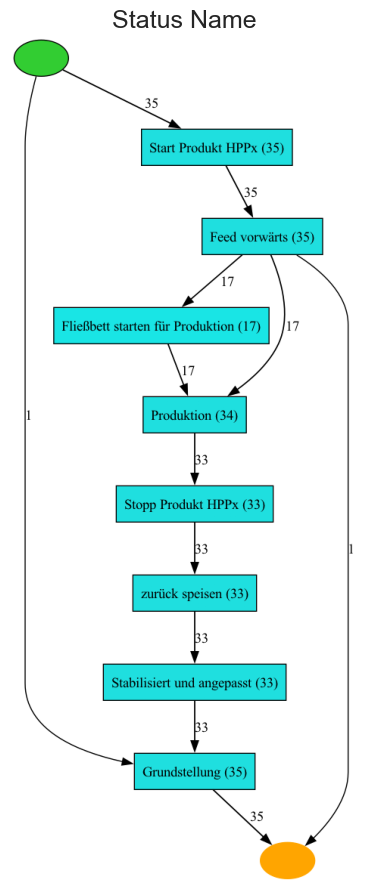

In [ ]:
import pm4py
import matplotlib.pyplot as plt
from pm4py.visualization.heuristics_net import visualizer as hn_visualizer

# Visualization for status_name
df = event_log

event_log = pm4py.format_dataframe(df, case_id='case_id', activity_key='activity', timestamp_key='timestamp_start')
event_log['recipe'] = 'A'
map_ = pm4py.discover_heuristics_net(event_log)
gviz = hn_visualizer.apply(map_)
hn_visualizer.save(gviz, "heuristics_net.png")

# Display the image
fig, ax = plt.subplots(figsize=(11, 11))  # Adjust the width and height as needed

# Load and display the image
img = plt.imread("heuristics_net.png")
ax.imshow(img)
ax.axis('off')  # Hide the axis
ax.set_title('Status Name')

# Save the combined image
#plt.savefig('/Users/davidzapata/Documents/git/heattransplan/src/notebooks/visuals/heuristics_net_status_name.png')

# Show the plot
plt.show()

In [ ]:
import pandas as pd
import pm4py
from pm4py.algo.discovery.dfg import algorithm as dfg_algo
from pm4py.objects.conversion.log import converter as log_converter
from pm4py.objects.log.util import dataframe_utils

def extract_sim_config(df_input: pd.DataFrame):

    config = {
        "recipes": {}
    }
    for recipe in df_input['recipe'].unique():

        event_log_df = df_input.copy()

        event_log_df = event_log_df[event_log_df['recipe'] == recipe].copy()
        # Calculate durations
        event_log_df['duration'] = (event_log_df['timestamp_end'] - event_log_df['timestamp_start']).dt.total_seconds()

        # Ensure datetime format
        event_log_df = dataframe_utils.convert_timestamp_columns_in_df(event_log_df)

        # Convert pandas DataFrame to PM4Py EventLog
        log = log_converter.apply(event_log_df, variant=log_converter.Variants.TO_EVENT_LOG, parameters={"case_id_key": "case_id"})

        # 1. Extract DFG
        dfg = dfg_algo.apply(log)

        # Convert DFG to probabilistic process graph
        successors_count = {}
        total_outgoing = {}

        for (src, tgt), freq in dfg.items():
            if src not in successors_count:
                successors_count[src] = {}
            successors_count[src][tgt] = freq
            total_outgoing[src] = total_outgoing.get(src, 0) + freq

        process_graph = {}
        for src, targets in successors_count.items():
            process_graph[src] = {}
            for tgt, freq in targets.items():
                process_graph[src][tgt] = freq / total_outgoing[src]

        # 2. Compute process times
        time_stats = event_log_df.groupby("activity")["duration"].agg(['mean', 'std']).fillna(0)
        process_times = {
            activity: (row["mean"], row["std"])
            for activity, row in time_stats.iterrows()
        }

        # 3. Infer start activity
        start_activities = event_log_df.sort_values("timestamp_start").groupby("case_id").first()["activity"]
        start_activity = start_activities.value_counts().idxmax()

        sim_config = {
            "start": start_activity,
            "process_times": process_times,
            "process_graph": process_graph
        }

        config["recipes"][recipe] = sim_config    

    return config

event_log_pm = pm4py.format_dataframe(event_log, case_id='case_id', activity_key='activity', timestamp_key='timestamp_start')
config_new = extract_sim_config(event_log_pm)
config_new 

{'recipes': {'A': {'start': 'Start Produkt HPPx',
   'process_times': {'Feed vorwärts': (10175.142857142857, 16511.03274131797),
    'Fließbett starten für Produktion': (22338.235294117647,
     27870.331500381846),
    'Grundstellung': (1211.7142857142858, 371.24976303645207),
    'Produktion': (200.2941176470588, 629.369503137466),
    'Stabilisiert und angepasst': (16058.787878787878, 42888.86931343433),
    'Start Produkt HPPx': (264.85714285714283, 51.69886951610931),
    'Stopp Produkt HPPx': (187.57575757575756, 12.997668788647987),
    'zurück speisen': (98.18181818181819, 30.56290086184407)},
   'process_graph': {'Start Produkt HPPx': {'Feed vorwärts': 1.0},
    'Feed vorwärts': {'Produktion': 0.5,
     'Fließbett starten für Produktion': 0.5},
    'Produktion': {'Stopp Produkt HPPx': 0.9705882352941176,
     'Grundstellung': 0.029411764705882353},
    'Stopp Produkt HPPx': {'zurück speisen': 1.0},
    'zurück speisen': {'Stabilisiert und angepasst': 1.0},
    'Stabilisiert un

In [ ]:
# config_new  = {'recipes': {'A': {'start': 'Grundstellung',
#    'process_times': {'Feed vorwärts': (10175.142857142857, 16511.03274131797),
#     'Fließbett starten für Produktion': (22338.235294117647,
#      27870.331500381842),
#     'Grundstellung': (1211.7142857142858, 371.2497630364521),
#     'Produktion': (200.2941176470588, 629.369503137466),
#     'Stabilisiert und angepasst': (16058.787878787878, 42888.86931343433),
#     'Start Produkt HPPx': (264.85714285714283, 51.69886951610931),
#     'Stopp Produkt HPPx': (187.57575757575756, 12.997668788647985),
#     'zurück speisen': (98.18181818181819, 30.56290086184407)},
#    'process_graph': {'Grundstellung': {'Start Produkt HPPx': 1.0},
#     'Start Produkt HPPx': {'Feed vorwärts': 1.0},
#     'Feed vorwärts': {'Fließbett starten für Produktion': 0.4857142857142857,
#      'Produktion': 0.5142857142857142},
#     'Fließbett starten für Produktion': {'Produktion': 1.0},
#     'Produktion': {'Stopp Produkt HPPx': 0.9705882352941176,
#      'Grundstellung': 0.029411764705882353},
#     'Stopp Produkt HPPx': {'zurück speisen': 1.0},
#     'zurück speisen': {'Stabilisiert und angepasst': 1.0},
#     'Stabilisiert und angepasst': {'Grundstellung': 0},
#     }}}}

In [ ]:
# sim with exclusions

def run_simulation(production_plan: pd.DataFrame, config: dict, seed: int = 42, mutual_exclusion_groups=None):
    random.seed(seed)
    np.random.seed(seed)

    env = simpy.Environment()
    event_log = []

    all_activities = set()
    for recipe in config['recipes'].values():
        all_activities.update(recipe['process_times'].keys())

    # Resource per activity
    resources = {
        name: simpy.Resource(env, capacity=1)
        for name in all_activities
    }

    # --- Setup mutual exclusion resources ---
    # Map activity -> group_resource
    activity_to_mutex_resource = {}

    if mutual_exclusion_groups:
        for group in mutual_exclusion_groups:
            group_resource = simpy.Resource(env, capacity=1)
            for activity in group:
                activity_to_mutex_resource[activity] = group_resource

    def process_task(env, case_id, recipe_name, custom_times=None, coerce=False):
        recipe = config['recipes'][recipe_name]
        process_graph = recipe['process_graph']
        default_process_times = recipe['process_times']
        current_activity = recipe['start']

        while current_activity:
            # --- Coerce check ---
            if coerce and (not custom_times or current_activity not in custom_times):
                raise ValueError(
                    f"[case_id={case_id}] Missing process time for required activity '{current_activity}' with coerce=True"
                )

            # Use custom time if provided, else fall back to default
            if custom_times and current_activity in custom_times:
                duration, variability = custom_times[current_activity]
            else:
                duration, variability = default_process_times[current_activity]

            actual_duration = max(0, np.random.normal(duration, variability))

            # Main and mutex resources
            with resources[current_activity].request() as req:
                if current_activity in activity_to_mutex_resource:
                    with activity_to_mutex_resource[current_activity].request() as mutex_req:
                        yield req & mutex_req
                        time_start = env.now
                        yield env.timeout(actual_duration)
                        time_end = env.now
                else:
                    yield req
                    time_start = env.now
                    yield env.timeout(actual_duration)
                    time_end = env.now

            event_log.append({
                "timestamp_start": time_start,
                "timestamp_end": time_end,
                "activity": current_activity,
                "case_id": case_id,
                "recipe": recipe_name,
            })

            # Transition to next activity
            if current_activity in process_graph:
                next_steps = process_graph[current_activity]
                if next_steps:
                    activities, probabilities = zip(*next_steps.items())
                    current_activity = random.choices(activities, probabilities)[0]
                else:
                    current_activity = None
            else:
                current_activity = None

    # Schedule production plan
    for _, row in production_plan.iterrows():
        custom_times = row.get('custom_process_times', None)
        coerce = row.get('coerce', False)
        env.process(process_task(env, row['case_id'], row['recipe'], custom_times, coerce))

    env.run()
    return pd.DataFrame(event_log)

In [ ]:
import pandas as pd
import numpy as np

pd.set_option('display.max_rows', 20)

def generate_pallets(num_pallets, percentage_mtbf, MTTR, seed=None):
    # Set the random seed for reproducibility
    if seed is not None:
        np.random.seed(seed)

    # Define the recipes and volumes
    recipes = list('ABCD')
    volumes = [800, 900, 1000]
    processes = ['Autoclaving']

    # Initialize an empty list to store the rows
    data = []

    order_nr = 1
    # Generate the data
    while len(data) < num_pallets:
        for recipe in recipes:
            if len(data) >= num_pallets:
                break
            num_recipe_pallets = np.random.randint(1, min(20, num_pallets - len(data) + 1))  # Limit to max 20 repetitions
            for _ in range(num_recipe_pallets):
                if len(data) >= num_pallets:
                    break
                data.append({'order_id': order_nr, 'recipe': recipe, 'downtime': {}})
            order_nr += 1  # Increment the order number after finishing with a recipe
            if len(data) < num_pallets:
                data.append({'order_id': order_nr, 'recipe': 'cleaning', 'downtime': {}})
            order_nr += 1  # Increment the order number after adding a cleaning step

    # Add downtimes
    for _ in range(int(num_pallets * percentage_mtbf)): 
        downtime_process = np.random.choice(processes)
        downtime_duration = np.random.uniform(MTTR - 10, MTTR + 10)  # Downtime duration MTTR ± 10 minutes
        case_id = np.random.randint(0, num_pallets)
        if 'downtime' not in data[case_id]:
            data[case_id]['downtime'] = {}
        data[case_id]['downtime'][downtime_process] = downtime_duration

    # Create the DataFrame
    df = pd.DataFrame(data[:num_pallets])

    return df

minutes_in_year = 365 * 24 * 60
number_failures_in_year = 100
MTBF = minutes_in_year / number_failures_in_year
percentage_mtbf = MTBF / minutes_in_year

# Specify the number of pallets and the random seed
MTTR = 30
num_pallets = 150
seed = 42
production_plan = generate_pallets(num_pallets, percentage_mtbf, MTTR, seed).reset_index().rename(columns={'index': 'case_id'})

production_plan['case_id'] = production_plan['case_id'] + 1

# Filter out unwanted recipes and reset the index
production_plan = production_plan[production_plan['recipe'].isin(['A', 'B', 'C'])].reset_index(drop=True)

# Create the 'case_id' based on the reset index
production_plan['case_id'] = production_plan.index.astype(int)

# Select only the 'recipe' and 'case_id' columns
filtered_plan = production_plan[['recipe', 'case_id']]

# Divide the recipes into 30% for every case_id
# Calculate the number of rows to sample (30% of the total rows)
sample_size = int(len(filtered_plan) * 0.3)

# Randomly sample 30% of the rows
production_plan = filtered_plan.sample(n=sample_size, random_state=seed).reset_index(drop = True).reset_index()
production_plan['case_id'] = production_plan['index'] + 1

# Print the resulting DataFrame
df_plan = production_plan

df_plan['recipe'] = 'A'

In [ ]:
df = run_simulation(df_plan, config_new)

# Define the base start date (01.01.2024)
base_date = pd.to_datetime('2024-01-01')

# Convert timestamp_start and timestamp_end to datetime based on the seconds
df['timestamp_start'] = base_date + pd.to_timedelta(df['timestamp_start'], unit='s')
df['timestamp_end'] = base_date + pd.to_timedelta(df['timestamp_end'], unit='s')

# Show the updated dataframe
event_log_new = df.copy()
event_log_new

,timestamp_start,timestamp_end,activity,case_id,recipe
0,2024-01-01 00:00:00.000000000,2024-01-01 00:04:50.536703040,Start Produkt HPPx,1,A
1,2024-01-01 00:04:50.536703040,2024-01-01 00:09:08.245737833,Start Produkt HPPx,2,A
2,2024-01-01 00:09:08.245737833,2024-01-01 00:14:06.587645908,Start Produkt HPPx,3,A
3,2024-01-01 00:14:06.587645908,2024-01-01 00:19:50.183710581,Start Produkt HPPx,4,A
4,2024-01-01 00:19:50.183710581,2024-01-01 00:24:02.935388671,Start Produkt HPPx,5,A
...,...,...,...,...,...
234,2024-01-10 20:24:36.198743313,2024-01-10 20:24:36.198743313,Stabilisiert und angepasst,29,A
235,2024-01-10 20:24:36.198743313,2024-01-10 20:24:36.198743313,Stabilisiert und angepasst,31,A
236,2024-01-10 20:24:36.198743313,2024-01-10 20:32:16.079323615,Grundstellung,27,A
237,2024-01-10 20:32:16.079323615,2024-01-10 20:53:37.014729505,Grundstellung,29,A


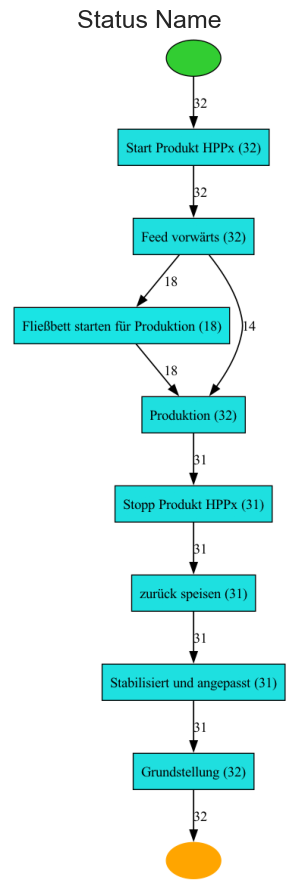

In [ ]:
import pm4py
import matplotlib.pyplot as plt
from pm4py.visualization.heuristics_net import visualizer as hn_visualizer

# Visualization for status_name
df = event_log_new


event_log = pm4py.format_dataframe(df, case_id='case_id', activity_key='activity', timestamp_key='timestamp_start')
event_log['recipe'] = 'A'
map_ = pm4py.discover_heuristics_net(event_log)
gviz = hn_visualizer.apply(map_)
hn_visualizer.save(gviz, "heuristics_net.png")

# Display the image
fig, ax = plt.subplots(figsize=(11, 11))  # Adjust the width and height as needed

# Load and display the image
img = plt.imread("heuristics_net.png")
ax.imshow(img)
ax.axis('off')  # Hide the axis
ax.set_title('Status Name')

# Save the combined image
#plt.savefig('/Users/davidzapata/Documents/git/heattransplan/src/notebooks/visuals/heuristics_net_status_name.png')

# Show the plot
plt.show()

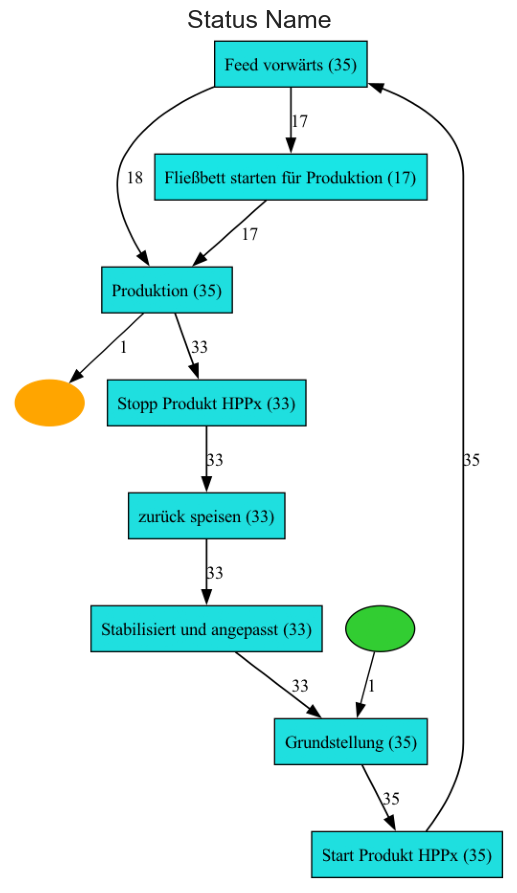

In [ ]:
import pm4py
import matplotlib.pyplot as plt
from pm4py.visualization.heuristics_net import visualizer as hn_visualizer

# Visualization for status_name
df = df_calculations[['datetime', 'status_name']].reset_index()
df['index'] = 1
df = df[['datetime', 'status_name', 'index']]
df.columns = ['timestamp', 'activity', 'case_id']
df = df[df['activity'] != df['activity'].shift(-1)]


event_log = pm4py.format_dataframe(df, case_id='case_id', activity_key='activity', timestamp_key='timestamp')
event_log['recipe'] = 'A'
map_ = pm4py.discover_heuristics_net(event_log)
gviz = hn_visualizer.apply(map_)
hn_visualizer.save(gviz, "heuristics_net.png")

# Display the image
fig, ax = plt.subplots(figsize=(11, 11))  # Adjust the width and height as needed

# Load and display the image
img = plt.imread("heuristics_net.png")
ax.imshow(img)
ax.axis('off')  # Hide the axis
ax.set_title('Status Name')

# Save the combined image
#plt.savefig('/Users/davidzapata/Documents/git/heattransplan/src/notebooks/visuals/heuristics_net_status_name.png')

# Show the plot
plt.show()

In [ ]:
event_log

,timestamp,activity,case_id,case:concept:name,concept:name,time:timestamp,@@index,@@case_index,recipe,start_timestamp
0,2024-11-04 09:00:21+00:00,Grundstellung,1,1,Grundstellung,2024-11-04 09:00:21+00:00,0,0,A,2024-11-04 09:00:21+00:00
1,2024-11-04 09:17:41+00:00,Start Produkt HPPx,1,1,Start Produkt HPPx,2024-11-04 09:17:41+00:00,1,0,A,2024-11-04 09:17:41+00:00
2,2024-11-04 09:22:31+00:00,Feed vorwärts,1,1,Feed vorwärts,2024-11-04 09:22:31+00:00,2,0,A,2024-11-04 09:22:31+00:00
3,2024-11-04 09:23:31+00:00,Fließbett starten für Produktion,1,1,Fließbett starten für Produktion,2024-11-04 09:23:31+00:00,3,0,A,2024-11-04 09:23:31+00:00
4,2024-11-04 10:10:31+00:00,Produktion,1,1,Produktion,2024-11-04 10:10:31+00:00,4,0,A,2024-11-04 10:10:31+00:00
...,...,...,...,...,...,...,...,...,...,...
251,2024-11-19 16:15:31+00:00,Stabilisiert und angepasst,1,1,Stabilisiert und angepasst,2024-11-19 16:15:31+00:00,251,0,A,2024-11-19 16:15:31+00:00
252,2024-11-19 16:33:01+00:00,Grundstellung,1,1,Grundstellung,2024-11-19 16:33:01+00:00,252,0,A,2024-11-19 16:33:01+00:00
253,2024-11-19 16:51:11+00:00,Start Produkt HPPx,1,1,Start Produkt HPPx,2024-11-19 16:51:11+00:00,253,0,A,2024-11-19 16:51:11+00:00
254,2024-11-19 16:55:51+00:00,Feed vorwärts,1,1,Feed vorwärts,2024-11-19 16:55:51+00:00,254,0,A,2024-11-19 16:55:51+00:00


In [ ]:
# import pm4py
# import matplotlib.pyplot as plt
# from pm4py.visualization.heuristics_net import visualizer as hn_visualizer

# df = df_calculations.copy()

# # Filter the DataFrame
# df = df[df['status_name_l01'].isin(['Grundstellung', 'Produktion', 'Warten auf Ziel'])]
# df = df[df['status_name_l02'].isin(['Grundstellung', 'Produktion', 'Warten auf Ziel'])]

# # Combine the status_name_l01 and status_name_l02 into a single column
# # df['status_name'] = df['status_name_l01'] + ' & ' + df['status_name_l02']

# # Create the event log
# df_event_log = df[['datetime', 'status_name']].reset_index()
# df_event_log['index'] = 1
# df_event_log = df_event_log[['datetime', 'status_name', 'index']]
# df_event_log.columns = ['timestamp', 'activity', 'case_id']
# df_event_log = df_event_log[df_event_log['activity'] != df_event_log['activity'].shift(-1)]
# event_log = pm4py.format_dataframe(df_event_log, case_id='case_id', activity_key='activity', timestamp_key='timestamp')

# # Discover the heuristics net
# map_ = pm4py.discover_heuristics_net(event_log)
# gviz = hn_visualizer.apply(map_)
# hn_visualizer.save(gviz, "heuristics_net.png")

# # Display the image
# fig, ax = plt.subplots(figsize=(11, 11))  # Adjust the width and height as needed

# # Load and display the image
# img = plt.imread("heuristics_net.png")
# ax.imshow(img)
# ax.axis('off')  # Hide the axis
# ax.set_title('Status Name')

# # Save the combined image
# plt.savefig('/Users/davidzapata/Documents/git/heattransplan/src/notebooks/visuals/heuristics_net_status_name.png')

# # Show the plot
# plt.show()

# Ende der Exploration

- [Index](#Index)

 # Visualize all variables per hour

Visualisierung und beschreibene Statistiken von jeder Variable zum besseren Datenverständnis: nicht relevant für die Analyse.

In [ ]:
#### The variables are resampled per hour
pd.set_option('display.max_rows', 10)

# Display the resampled DataFrame
display(df_resampled_1H)
visualize_data(df_resampled_1H, datetime_col="datetime", library="plotly")

,datetime,(2)_zuluft_vor_entfeuchter_kon_g/kg,(3)_zuluft_nach_entfeuchter_kon_g/kg,(4)_frostschutz_%,(5)_vor_vent_hauptzuluft_temp_c,(7)_zuluft_turmt_temp_c,(9)_abluft2_kon_g/kg,(11)_wm_mas_kg/h,(12)_mpt_fb(mpt?)_kg/h,(13)_lanzen_mas_kg/h,...,wind_direction_100m,global_tilted_irradiance,(21)_zuluft_turm_mas_kg/h,(31)_q_waerme_recu_kw,(22)_t_waermereg_c,(33)_q_lufterwearmung_dampgemessen_und_berechnete_recu_kw,(34)_q_lufterwearmung_berechnet_nach_temp_in_out_kw,(1)_status,id_original,status_name
0,2024-11-03 00:00:00,3.919533,7.943714,15.0,32.331533,92.643852,6.216689,5000.0,1.285560,0.070726,...,142.648309,0.0,-15002.700371,-111.931792,411.097527,-75.489226,-252.603306,0,8701,Grundstellung
1,2024-11-03 01:00:00,3.664129,7.746667,15.0,32.565333,91.866159,6.123618,5000.0,1.420637,0.077763,...,147.076825,0.0,-15003.071700,-110.955319,405.225240,-77.148444,-248.373064,0,8701,Grundstellung
2,2024-11-03 02:00:00,3.471574,7.160680,15.0,33.290222,91.301279,5.798050,5000.0,1.543210,0.080978,...,154.083485,0.0,-15003.032105,-107.918927,418.802803,-66.137052,-242.970386,0,8701,Grundstellung
3,2024-11-03 03:00:00,3.403679,6.417020,15.0,34.843833,91.102999,5.852712,5000.0,1.468862,0.072539,...,156.935550,0.0,-15002.881497,-101.410875,407.889371,-57.494000,-235.630522,0,8701,Grundstellung
4,2024-11-03 04:00:00,3.270131,5.696555,15.0,36.262111,90.954625,5.686960,5000.0,1.434703,0.083189,...,161.828375,0.0,-15002.891804,-95.470738,383.384168,-51.201863,-229.069046,0,8701,Grundstellung
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
399,2024-11-19 15:00:00,3.657051,2.850873,15.0,19.011389,174.904912,21.935983,5000.0,14480.263780,1418.446179,...,331.030110,2.5,40279.987850,292.235399,64.894865,2200.735399,1753.013540,70,8707,Produktion
400,2024-11-19 16:00:00,3.642821,2.960568,15.0,18.083112,174.880556,19.360269,5000.0,19228.786689,1388.806706,...,320.506275,0.5,37510.589402,281.443754,64.477373,2185.556254,1641.867284,70,8707,Produktion
401,2024-11-19 17:00:00,3.657615,2.980260,15.0,18.647000,174.946149,21.970302,5000.0,14618.921596,1426.562500,...,308.419875,0.0,39946.795790,294.521711,63.821064,2232.096711,1742.997397,70,8707,Produktion
402,2024-11-19 18:00:00,3.709307,2.969853,15.0,18.950334,174.959572,22.110171,5000.0,14589.725168,1422.277279,...,298.297485,0.0,40192.512585,292.417045,64.682076,2251.479545,1750.511293,70,8707,Produktion


Variable: (2)_zuluft_vor_entfeuchter_kon_g/kg


,count,mean,std,min,25%,50%,75%,max,unique
(2)_zuluft_vor_entfeuchter_kon_g/kg,404.0,5.017042,0.796177,3.1795,4.446377,4.990451,5.540173,7.373448,404


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (3)_zuluft_nach_entfeuchter_kon_g/kg


,count,mean,std,min,25%,50%,75%,max,unique
(3)_zuluft_nach_entfeuchter_kon_g/kg,404.0,3.903319,1.618465,2.365697,2.895807,2.932536,4.80387,9.198086,404


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (4)_frostschutz_%


,count,mean,std,min,25%,50%,75%,max,unique
(4)_frostschutz_%,404.0,15.000116,0.002322,15.0,15.0,15.0,15.0,15.046667,2


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (5)_vor_vent_hauptzuluft_temp_c


,count,mean,std,min,25%,50%,75%,max,unique
(5)_vor_vent_hauptzuluft_temp_c,404.0,30.676937,5.537918,17.503666,27.38232,29.840972,34.193222,42.4575,404


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (7)_zuluft_turmt_temp_c


,count,mean,std,min,25%,50%,75%,max,unique
(7)_zuluft_turmt_temp_c,404.0,138.746059,55.103442,26.23031,77.32659,175.05887,179.043355,183.588766,404


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (9)_abluft2_kon_g/kg


,count,mean,std,min,25%,50%,75%,max,unique
(9)_abluft2_kon_g/kg,404.0,4.113716,8.965109,-1.544669,-1.359907,-1.124871,7.065276,62.685913,404


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (11)_wm_mas_kg/h


,count,mean,std,min,25%,50%,75%,max,unique
(11)_wm_mas_kg/h,404.0,5000.0,0.0,5000.0,5000.0,5000.0,5000.0,5000.0,1


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (12)_mpt_fb(mpt?)_kg/h


,count,mean,std,min,25%,50%,75%,max,unique
(12)_mpt_fb(mpt?)_kg/h,404.0,10720.36651,7008.380914,1.243811,1.619567,14380.26864,15073.628503,20629.742399,400


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (13)_lanzen_mas_kg/h


,count,mean,std,min,25%,50%,75%,max,unique
(13)_lanzen_mas_kg/h,404.0,1147.777305,609.455017,0.056263,1273.81632,1477.262973,1493.327327,1669.916255,404


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (14)_filter_mas_kg/h


,count,mean,std,min,25%,50%,75%,max,unique
(14)_filter_mas_kg/h,404.0,2204.600023,1472.908419,0.129606,0.2248,3180.074303,3207.959969,3334.163208,404


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (15)_filter_mas_kg/h


,count,mean,std,min,25%,50%,75%,max,unique
(15)_filter_mas_kg/h,404.0,10000.0,0.0,10000.0,10000.0,10000.0,10000.0,10000.0,1


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (16)_konditionierung_mas_kg/h


,count,mean,std,min,25%,50%,75%,max,unique
(16)_konditionierung_mas_kg/h,404.0,8583.862055,5498.913707,0.758142,0.994647,11964.616386,12150.885023,16125.559578,402


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (8)_abluft_vol_m3/h


,count,mean,std,min,25%,50%,75%,max,unique
(8)_abluft_vol_m3/h,404.0,79779.768848,49918.092288,-0.497394,7693.696126,111218.27003,113735.298248,117253.211306,404


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (23)_f10_speise_temp_c


,count,mean,std,min,25%,50%,75%,max,unique
(23)_f10_speise_temp_c,404.0,40.390856,20.365211,15.572806,26.517123,33.08564,50.689772,78.589331,404


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (23)_f11_speise_temp_c


,count,mean,std,min,25%,50%,75%,max,unique
(23)_f11_speise_temp_c,404.0,42.550178,22.180741,15.217557,26.791322,33.027409,75.039406,78.709655,404


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (19)_zuluft_vor_entfeuchter_temp_c


,count,mean,std,min,25%,50%,75%,max,unique
(19)_zuluft_vor_entfeuchter_temp_c,404.0,6.687943,2.350554,1.91625,5.091875,6.289166,8.142397,13.566251,401


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: dampf_nmb_


,count,mean,std,min,25%,50%,75%,max,unique
dampf_nmb_,404.0,204.319689,265.148326,0.0,70.979366,145.825798,219.175488,1525.263029,390


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: nach_nt_(c)_


,count,mean,std,min,25%,50%,75%,max,unique
nach_nt_(c)_,404.0,44.399946,7.69614,20.74058,44.942592,45.022265,45.399748,66.179109,404


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: f10_speise_kg/h_


,count,mean,std,min,25%,50%,75%,max,unique
f10_speise_kg/h_,404.0,1421.05333,2009.492755,-6.614701,0.0,0.0,3460.618582,5862.89721,161


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: f11_speise_kg/h_


,count,mean,std,min,25%,50%,75%,max,unique
f11_speise_kg/h_,404.0,1862.378935,2189.88369,0.0,0.0,0.0,4537.418567,6141.731274,202


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: f10_speise_kg/m³_


,count,mean,std,min,25%,50%,75%,max,unique
f10_speise_kg/m³_,404.0,0.476603,0.508809,0.0001,0.000102,0.001128,0.996535,1.110318,309


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: f11_speise_kg/m³_


,count,mean,std,min,25%,50%,75%,max,unique
f11_speise_kg/m³_,404.0,0.515346,0.521383,0.0001,0.00024,0.268631,1.091689,1.111373,338


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: f10_speise_l/h_


,count,mean,std,min,25%,50%,75%,max,unique
f10_speise_l/h_,404.0,1335.797855,1881.198185,-10.097533,0.0,0.0,3333.399848,5939.329295,161


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: f11_speise_l/h_


,count,mean,std,min,25%,50%,75%,max,unique
f11_speise_l/h_,404.0,1743.012802,2050.308148,0.0,0.0,0.0,4141.977398,6215.453311,202


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (18)_leistung_turmF_lufterhitzer_kw


,count,mean,std,min,25%,50%,75%,max,unique
(18)_leistung_turmF_lufterhitzer_kw,404.0,67.533127,94.485638,-0.028147,-0.00402,5.37776,116.019435,352.81375,288


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (17)_leistung_turmF_luftentfeuchter_kw


,count,mean,std,min,25%,50%,75%,max,unique
(17)_leistung_turmF_luftentfeuchter_kw,404.0,1311.280916,881.679207,-0.357849,41.444594,1905.8125,1982.775,2107.0875,403


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (6)_nach_recu_reg_temp_c


,count,mean,std,min,25%,50%,75%,max,unique
(6)_nach_recu_reg_temp_c,404.0,44.471609,7.792343,20.74058,44.942592,45.022265,45.399748,66.179109,393


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (10)_abluft_temp_c


,count,mean,std,min,25%,50%,75%,max,unique
(10)_abluft_temp_c,404.0,59.489659,18.376942,27.283016,39.242265,69.567683,73.396107,82.008771,404


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (8)_abluft_mas_kg/h


,count,mean,std,min,25%,50%,75%,max,unique
(8)_abluft_mas_kg/h,404.0,61430.422013,38436.931062,-0.382993,5924.146017,85638.067923,87576.179651,90284.972706,404


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: temperature_2m


,count,mean,std,min,25%,50%,75%,max,unique
temperature_2m,404.0,6.268776,2.43152,0.159,4.709,6.659,7.8215,11.809,318


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: relative_humidity_2m


,count,mean,std,min,25%,50%,75%,max,unique
relative_humidity_2m,404.0,90.29811,7.553477,70.255177,85.146563,92.730868,96.371319,100.0,399


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: apparent_temperature


,count,mean,std,min,25%,50%,75%,max,unique
apparent_temperature,404.0,3.513241,2.92657,-3.459076,1.659117,3.542074,5.708246,10.067679,404


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: precipitation


,count,mean,std,min,25%,50%,75%,max,unique
precipitation,404.0,0.12896,0.446286,0.0,0.0,0.0,0.0,3.45,33


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: wind_speed_10m


,count,mean,std,min,25%,50%,75%,max,unique
wind_speed_10m,404.0,10.375074,4.712257,1.777352,6.843795,9.531044,13.614536,22.953656,403


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: wind_direction_100m


,count,mean,std,min,25%,50%,75%,max,unique
wind_direction_100m,404.0,190.795475,83.509293,19.584909,114.873295,221.95277,255.570846,356.57866,404


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: global_tilted_irradiance


,count,mean,std,min,25%,50%,75%,max,unique
global_tilted_irradiance,404.0,39.975247,73.097359,0.0,0.0,0.0,42.25,357.5,154


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (21)_zuluft_turm_mas_kg/h


,count,mean,std,min,25%,50%,75%,max,unique
(21)_zuluft_turm_mas_kg/h,404.0,23773.81612,24224.165833,-15017.287621,-10582.645739,38197.70385,40671.000169,44125.655159,404


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (31)_q_waerme_recu_kw


,count,mean,std,min,25%,50%,75%,max,unique
(31)_q_waerme_recu_kw,404.0,99.040203,109.588901,-163.952525,-5.863901,144.110103,181.787773,294.521711,404


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (22)_t_waermereg_c


,count,mean,std,min,25%,50%,75%,max,unique
(22)_t_waermereg_c,404.0,115.189149,119.361788,33.907759,68.805751,73.091854,76.086836,633.215135,404


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (33)_q_lufterwearmung_dampgemessen_und_berechnete_recu_kw


,count,mean,std,min,25%,50%,75%,max,unique
(33)_q_lufterwearmung_dampgemessen_und_berechnete_recu_kw,404.0,1410.321119,983.624476,-137.753025,16.209114,2071.37887,2163.873739,2370.158384,404


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (34)_q_lufterwearmung_berechnet_nach_temp_in_out_kw


,count,mean,std,min,25%,50%,75%,max,unique
(34)_q_lufterwearmung_berechnet_nach_temp_in_out_kw,404.0,1058.902177,824.966338,-252.603306,-16.67703,1618.256946,1681.132739,1948.912737,404


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (1)_status


,count,mean,std,min,25%,50%,75%,max,unique
(1)_status,404.0,37.252475,34.549574,0.0,0.0,70.0,70.0,110.0,6


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: id_original


,count,mean,std,min,25%,50%,75%,max,unique
id_original,404.0,8704.168317,2.963196,8701.0,8701.0,8707.0,8707.0,8710.0,6


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: status_name


,count,unique,top,freq
status_name,404,6,Produktion,205


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


 # Visualize all variables per minute


,datetime,(2)_zuluft_vor_entfeuchter_kon_g/kg,(3)_zuluft_nach_entfeuchter_kon_g/kg,(4)_frostschutz_%,(5)_vor_vent_hauptzuluft_temp_c,(7)_zuluft_turmt_temp_c,(9)_abluft2_kon_g/kg,(11)_wm_mas_kg/h,(12)_mpt_fb(mpt?)_kg/h,(13)_lanzen_mas_kg/h,...,wind_direction_100m,global_tilted_irradiance,(21)_zuluft_turm_mas_kg/h,(31)_q_waerme_recu_kw,(22)_t_waermereg_c,(33)_q_lufterwearmung_dampgemessen_und_berechnete_recu_kw,(34)_q_lufterwearmung_berechnet_nach_temp_in_out_kw,(1)_status,id_original,status_name
0,2024-11-03 00:07:30.999999744,3.989916,7.937936,15.0,32.348989,92.949566,6.298403,5000.0,1.227307,0.065023,...,141.46979,0.0,-15002.812240,-111.859515,416.449578,-79.805515,-253.812488,0,8701,Grundstellung
1,2024-11-03 00:22:26.000000000,3.953941,7.936171,15.0,32.308668,92.749486,6.213521,5000.0,1.269933,0.065104,...,141.46979,0.0,-15002.659391,-112.027253,409.810314,-79.225753,-253.140806,0,8701,Grundstellung
2,2024-11-03 00:37:26.000000000,3.924627,7.957456,15.0,32.342890,92.541147,6.154888,5000.0,1.454797,0.094843,...,143.82028,0.0,-15002.698453,-111.884212,414.293569,-73.952212,-252.125546,0,8701,Grundstellung
3,2024-11-03 00:52:26.000000000,3.810432,7.943229,15.0,32.325779,92.338607,6.200854,5000.0,1.189558,0.057870,...,143.82028,0.0,-15002.632641,-111.955383,403.896113,-69.021383,-251.347821,0,8701,Grundstellung
4,2024-11-03 01:07:25.999999744,3.763760,7.913623,15.0,32.395778,92.195217,6.149104,5000.0,1.543210,0.058674,...,143.82028,0.0,-15003.203103,-111.666456,413.292710,-76.613456,-250.463626,0,8701,Grundstellung
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1609,2024-11-19 18:22:26.000000000,3.693359,2.971526,15.0,18.862445,174.952417,22.093502,5000.0,14628.793696,1430.836065,...,301.57812,0.0,40240.107930,293.999197,64.678852,2255.649197,1753.478118,70,8707,Produktion
1610,2024-11-19 18:37:26.000000000,3.712374,2.991272,15.0,18.949556,174.964637,22.153586,5000.0,14591.161882,1424.607770,...,295.01685,0.0,40098.572993,291.030138,64.694095,2251.180138,1746.481462,70,8707,Produktion
1611,2024-11-19 18:52:26.000000000,3.743164,2.969914,15.0,19.106667,174.972995,22.130123,5000.0,14518.872179,1418.151200,...,295.01685,0.0,39810.631630,288.199283,64.772641,2240.249283,1732.279460,70,8707,Produktion
1612,2024-11-19 19:07:25.999999744,3.763985,3.011903,15.0,19.196889,174.950811,22.150545,5000.0,14542.976780,1430.043564,...,295.01685,0.0,40564.960236,292.296992,65.058799,2243.296992,1763.804134,70,8707,Produktion


Variable: (2)_zuluft_vor_entfeuchter_kon_g/kg


,count,mean,std,min,25%,50%,75%,max,unique
(2)_zuluft_vor_entfeuchter_kon_g/kg,1614.0,5.018574,0.819053,3.161487,4.440273,4.982649,5.535503,10.649564,1614


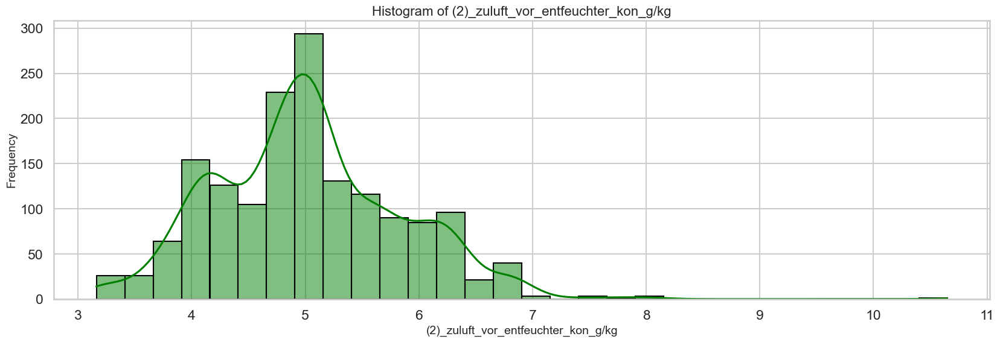

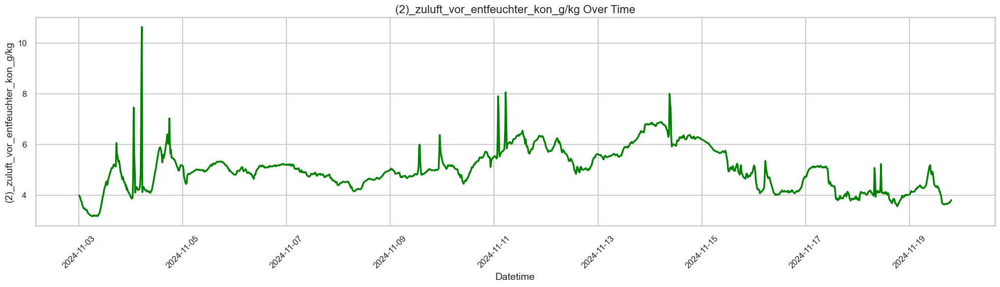

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (3)_zuluft_nach_entfeuchter_kon_g/kg


,count,mean,std,min,25%,50%,75%,max,unique
(3)_zuluft_nach_entfeuchter_kon_g/kg,1614.0,3.904428,1.629306,1.881206,2.89428,2.93948,4.687404,9.215498,1614


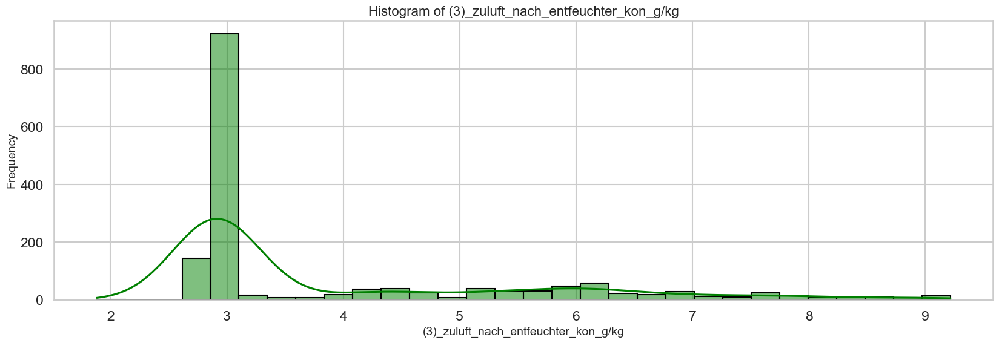

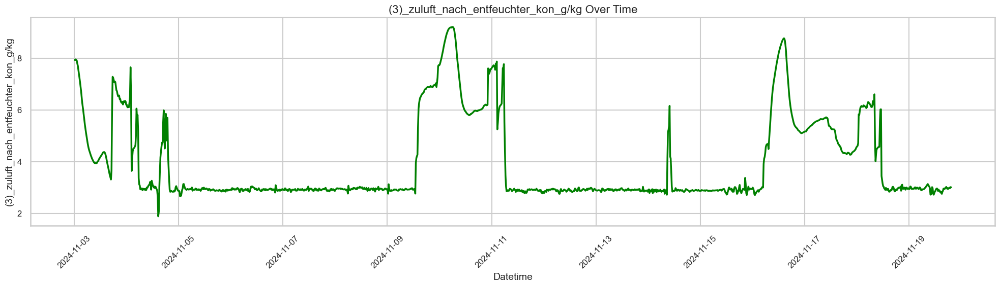

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (4)_frostschutz_%


,count,mean,std,min,25%,50%,75%,max,unique
(4)_frostschutz_%,1614.0,15.000116,0.004646,15.0,15.0,15.0,15.0,15.186667,2


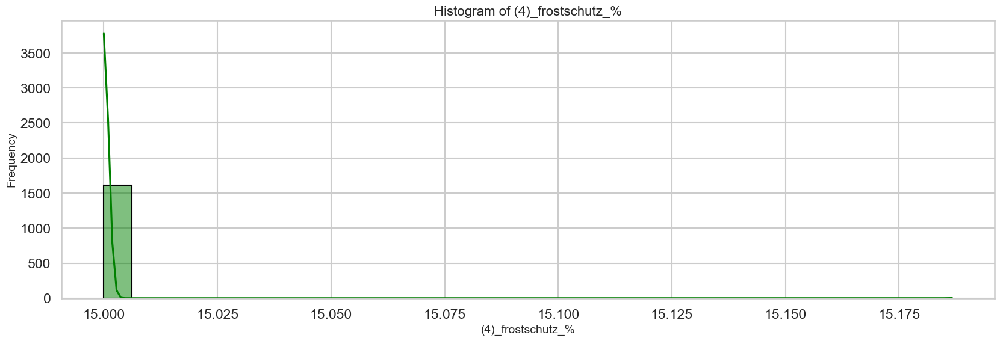

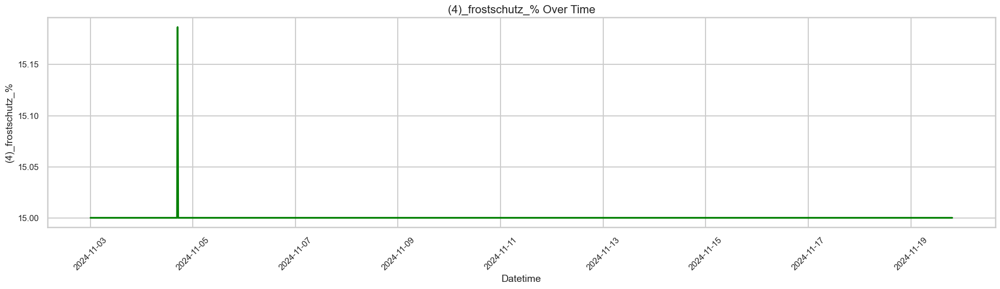

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (5)_vor_vent_hauptzuluft_temp_c


,count,mean,std,min,25%,50%,75%,max,unique
(5)_vor_vent_hauptzuluft_temp_c,1614.0,30.690968,5.556155,17.126444,27.337111,29.857111,34.266333,42.628222,1607


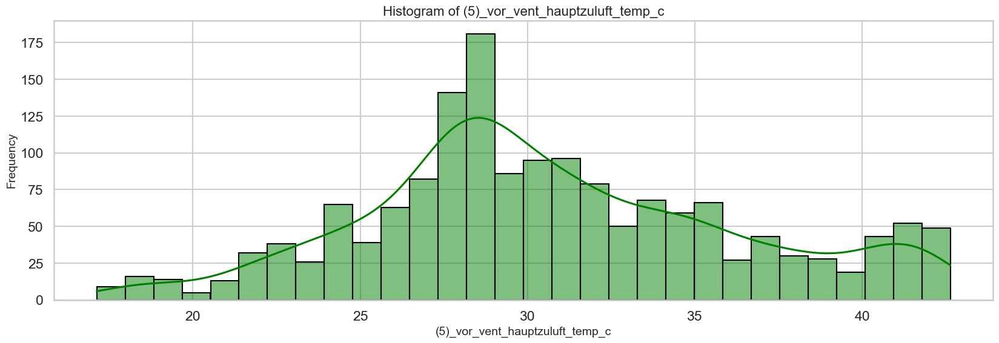

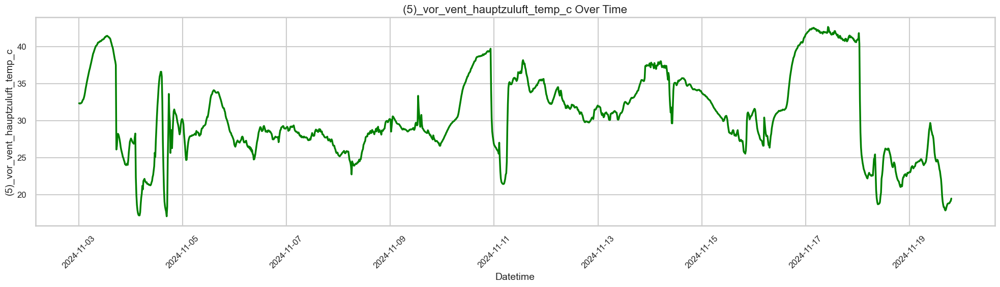

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (7)_zuluft_turmt_temp_c


,count,mean,std,min,25%,50%,75%,max,unique
(7)_zuluft_turmt_temp_c,1614.0,138.701211,55.835207,26.162874,76.906747,175.080368,179.159753,187.030286,1612


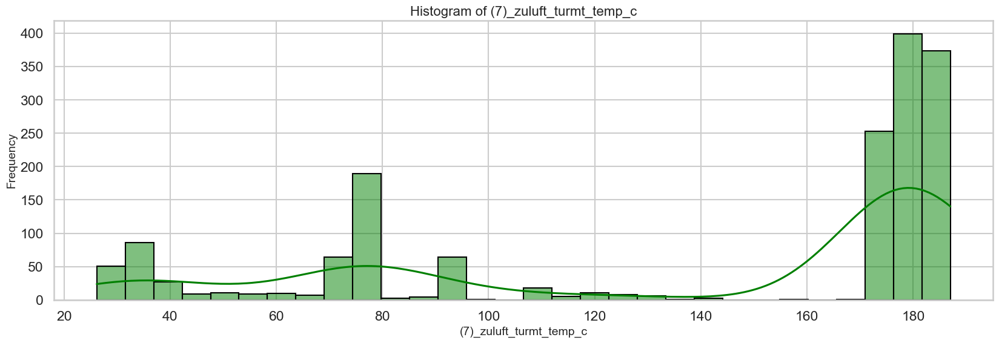

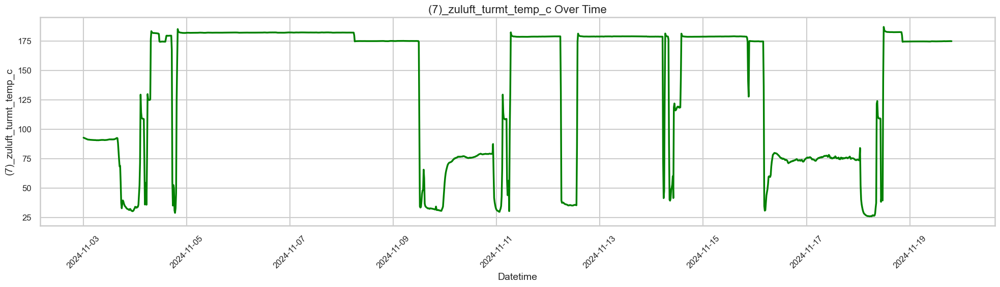

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (9)_abluft2_kon_g/kg


,count,mean,std,min,25%,50%,75%,max,unique
(9)_abluft2_kon_g/kg,1614.0,4.091399,9.175601,-1.55079,-1.36564,-1.125342,7.039137,67.779324,1614


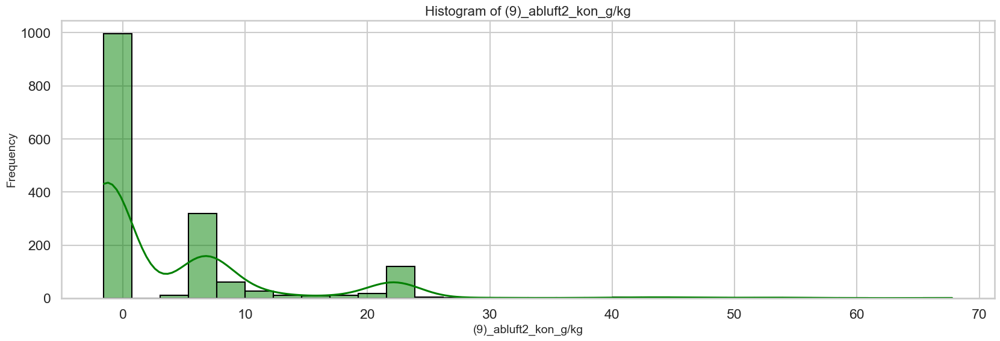

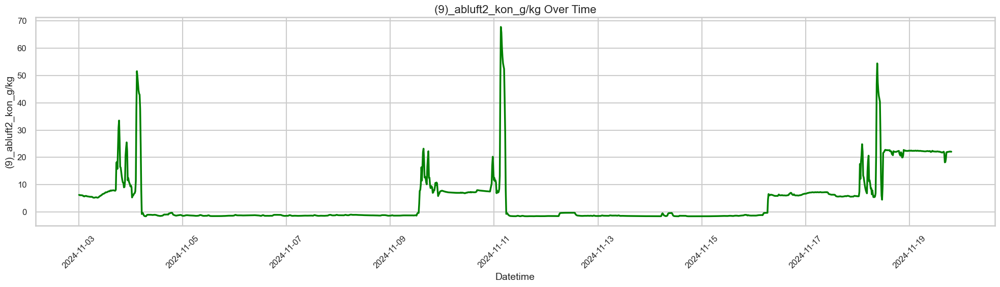

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (11)_wm_mas_kg/h


,count,mean,std,min,25%,50%,75%,max,unique
(11)_wm_mas_kg/h,1614.0,5000.0,0.0,5000.0,5000.0,5000.0,5000.0,5000.0,1


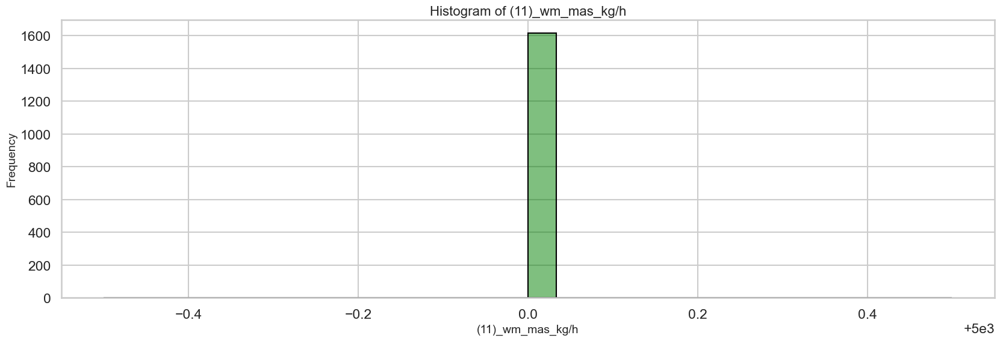

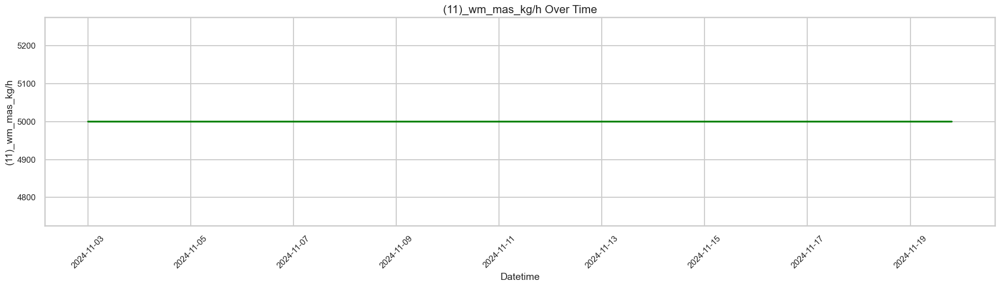

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (12)_mpt_fb(mpt?)_kg/h


,count,mean,std,min,25%,50%,75%,max,unique
(12)_mpt_fb(mpt?)_kg/h,1614.0,10715.619991,7151.920195,0.683192,1.663773,14381.229096,14942.06528,20630.546376,1471


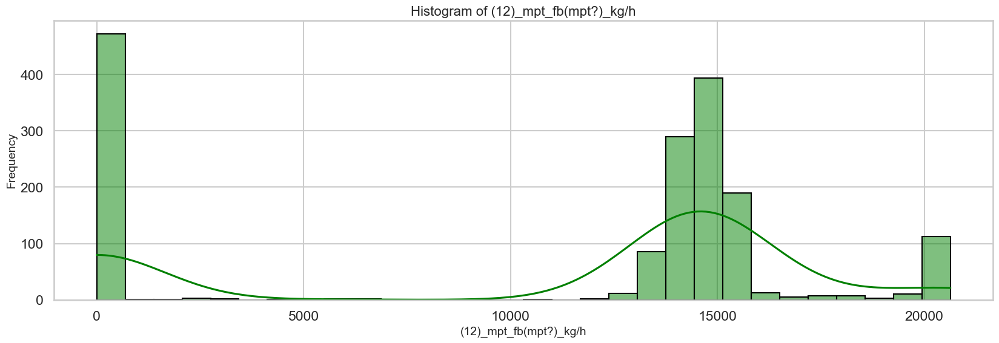

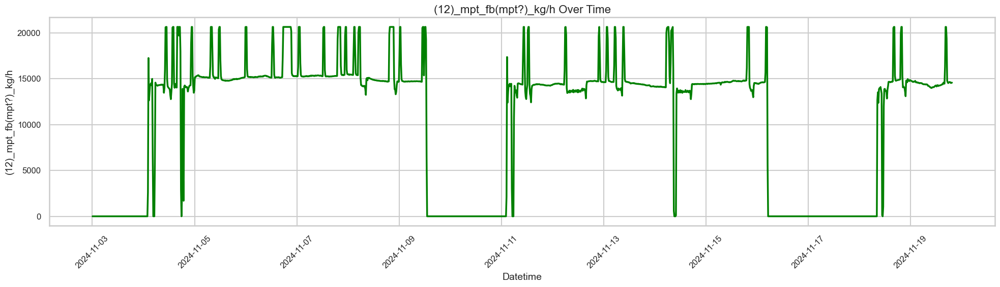

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (13)_lanzen_mas_kg/h


,count,mean,std,min,25%,50%,75%,max,unique
(13)_lanzen_mas_kg/h,1614.0,1147.42902,620.761129,0.024113,1306.737681,1477.728746,1496.864549,1900.739483,1607


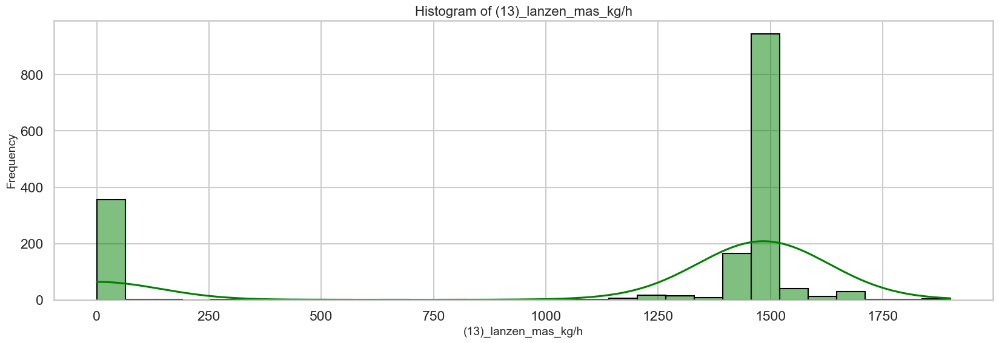

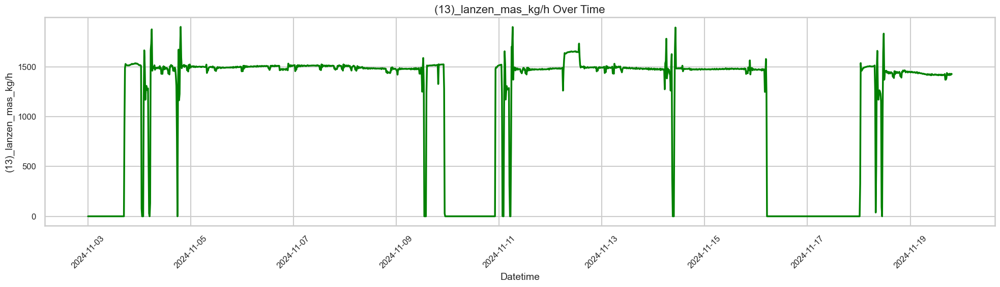

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (14)_filter_mas_kg/h


,count,mean,std,min,25%,50%,75%,max,unique
(14)_filter_mas_kg/h,1614.0,2203.473559,1479.642325,-0.285333,0.241127,3177.688159,3204.002595,3863.918207,1519


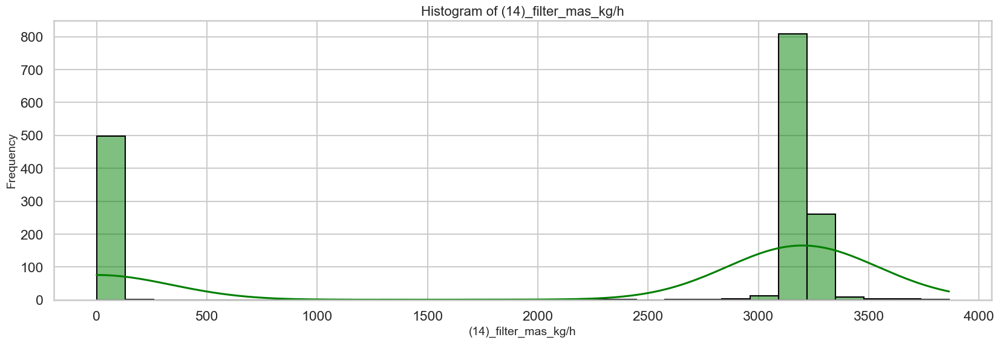

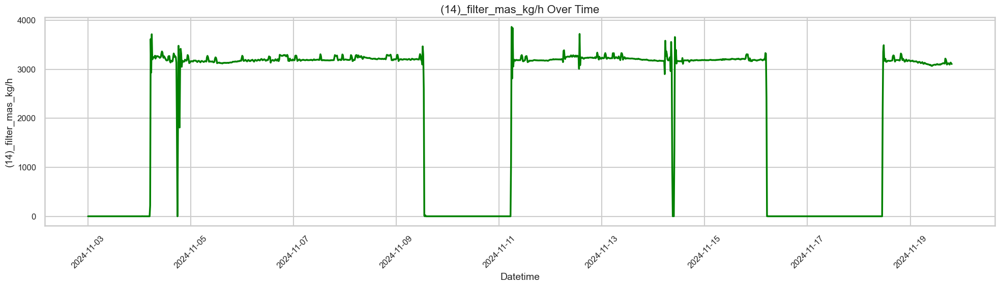

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (15)_filter_mas_kg/h


,count,mean,std,min,25%,50%,75%,max,unique
(15)_filter_mas_kg/h,1614.0,10000.0,0.0,10000.0,10000.0,10000.0,10000.0,10000.0,1


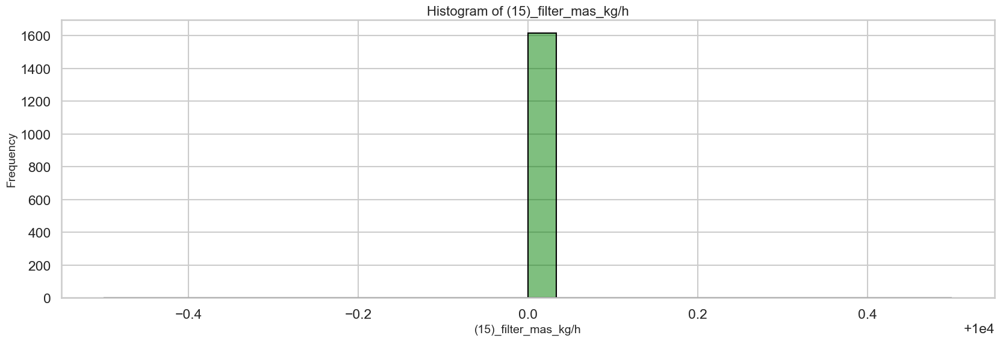

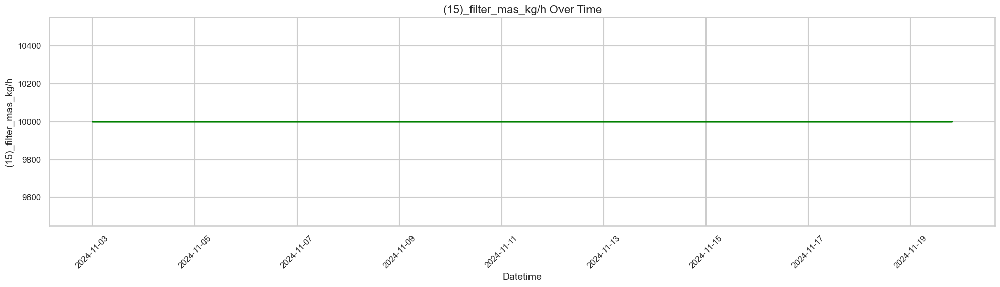

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (16)_konditionierung_mas_kg/h


,count,mean,std,min,25%,50%,75%,max,unique
(16)_konditionierung_mas_kg/h,1614.0,8579.712718,5604.266704,0.521637,1.060957,11962.451421,12153.611537,19288.618859,1549


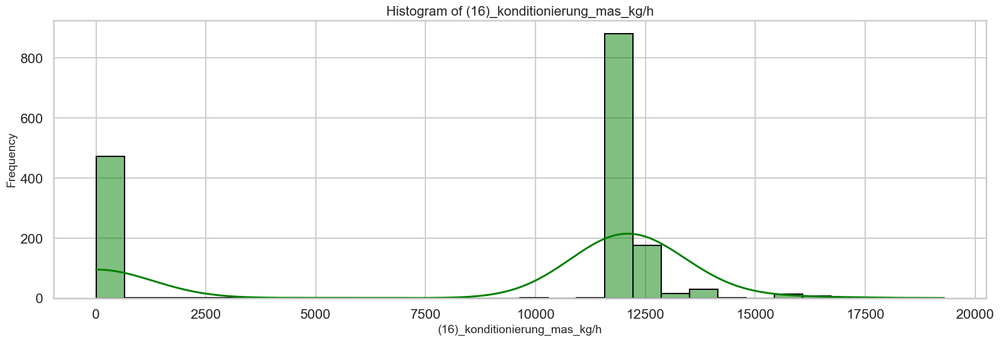

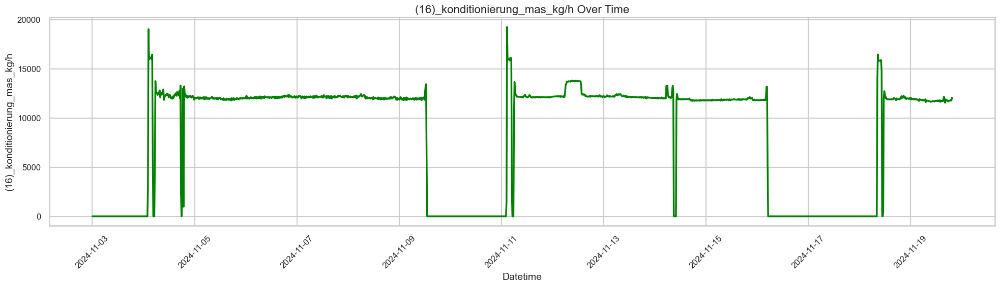

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (8)_abluft_vol_m3/h


,count,mean,std,min,25%,50%,75%,max,unique
(8)_abluft_vol_m3/h,1614.0,79739.8028,50406.602423,-0.537488,6877.210857,111166.564583,113812.402387,119261.897483,1614


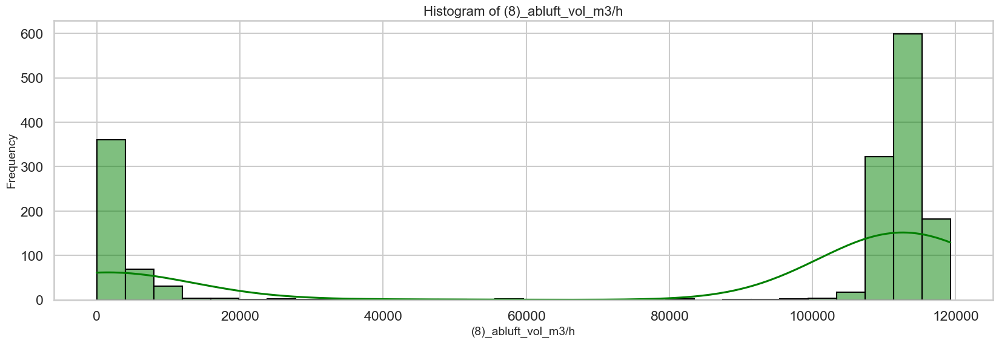

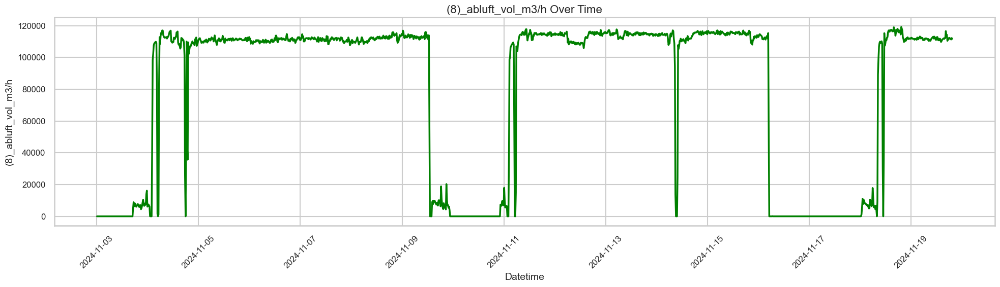

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (23)_f10_speise_temp_c


,count,mean,std,min,25%,50%,75%,max,unique
(23)_f10_speise_temp_c,1614.0,40.402488,21.365517,15.434434,26.39516,31.708561,52.04612,78.812106,1612


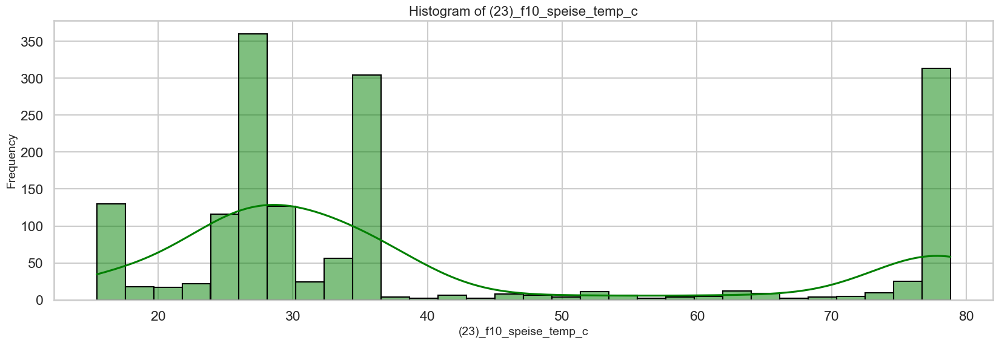

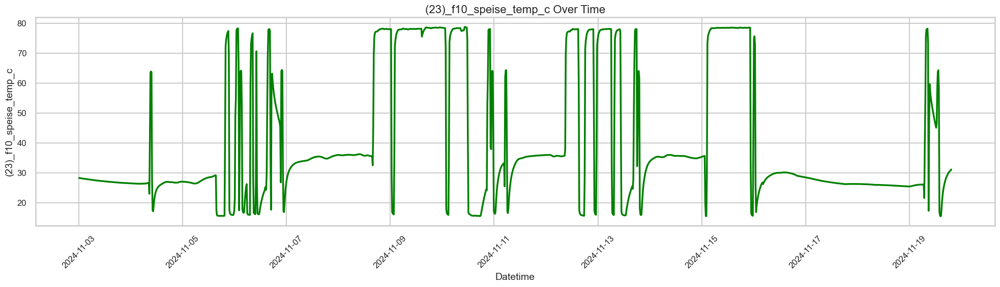

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (23)_f11_speise_temp_c


,count,mean,std,min,25%,50%,75%,max,unique
(23)_f11_speise_temp_c,1614.0,42.505813,22.841215,14.778525,26.671041,31.780204,76.276774,78.838764,1609


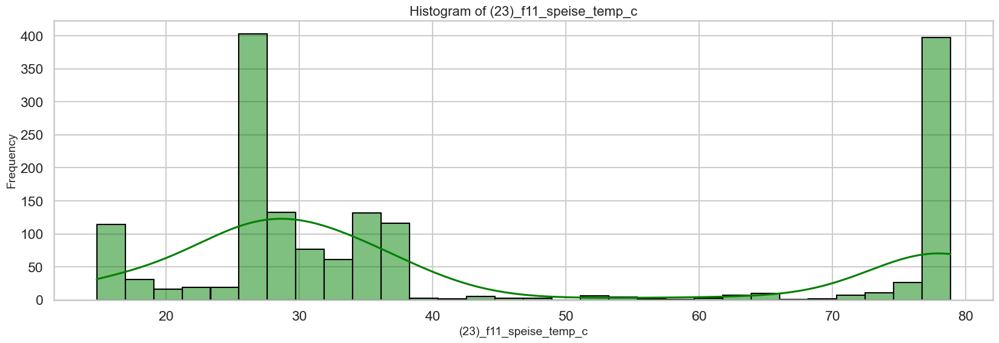

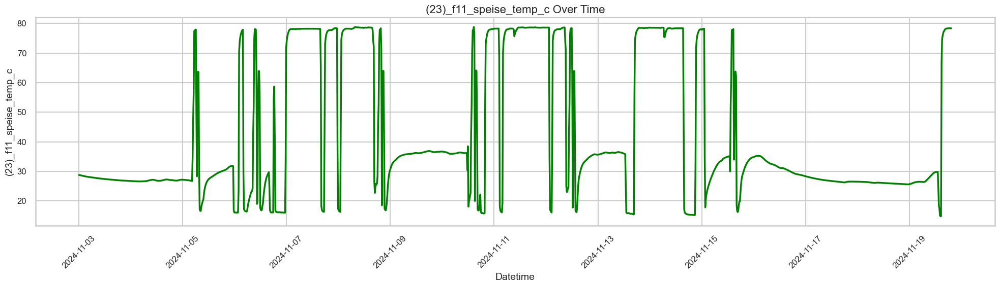

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (19)_zuluft_vor_entfeuchter_temp_c


,count,mean,std,min,25%,50%,75%,max,unique
(19)_zuluft_vor_entfeuchter_temp_c,1614.0,6.685371,2.352665,1.783333,5.099998,6.258332,8.130418,13.636668,1136


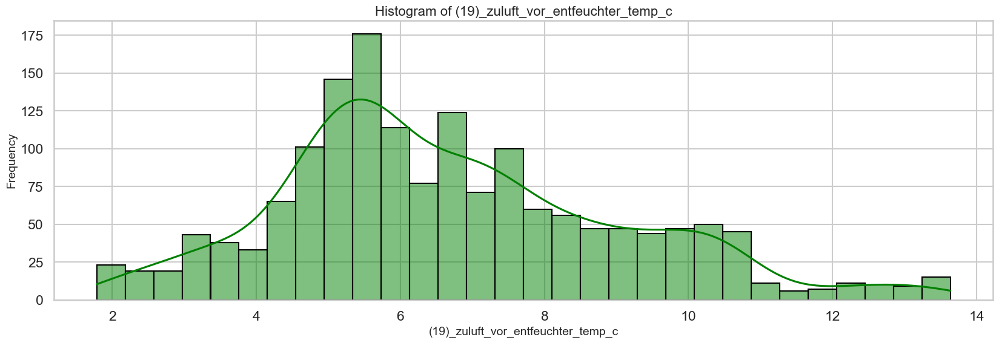

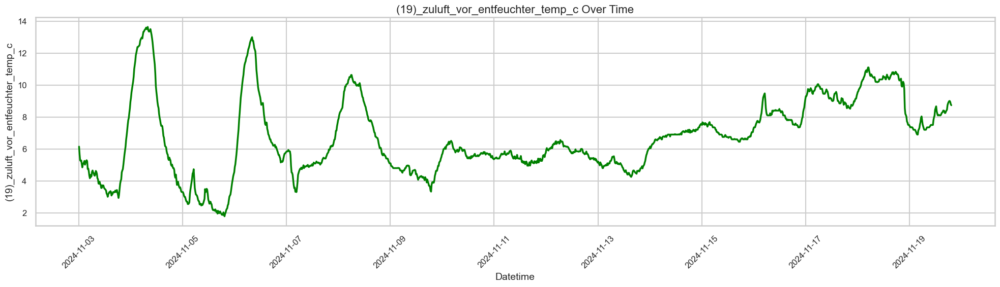

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: dampf_nmb_


,count,mean,std,min,25%,50%,75%,max,unique
dampf_nmb_,1614.0,204.447929,321.584171,0.0,0.0,73.519484,274.446212,2625.096456,1150


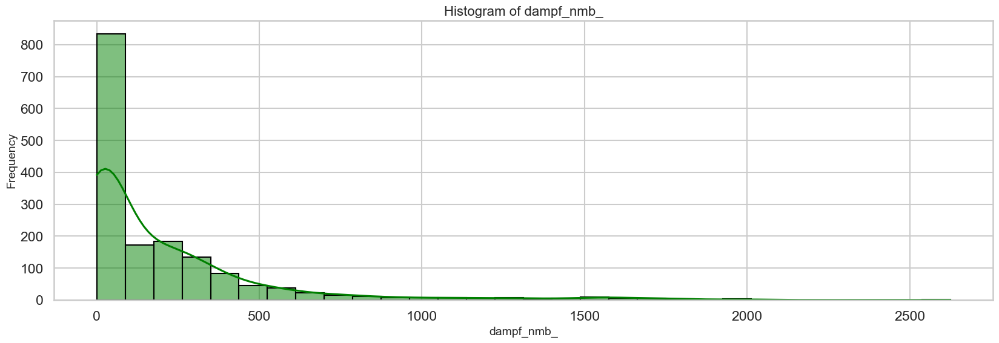

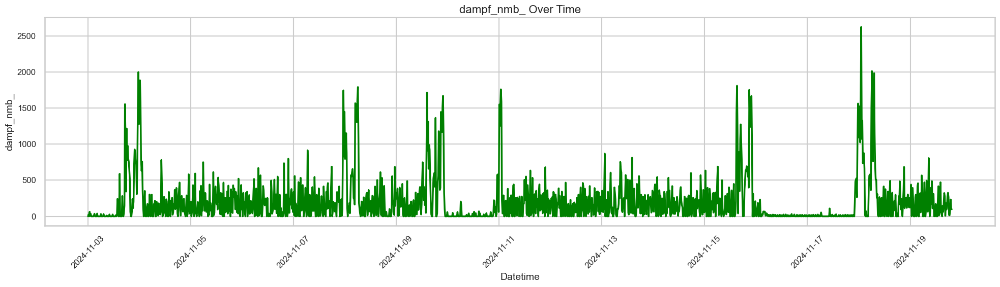

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: nach_nt_(c)_


,count,mean,std,min,25%,50%,75%,max,unique
nach_nt_(c)_,1614.0,44.399192,7.789466,20.354299,44.861673,45.048545,45.438288,68.099924,1606


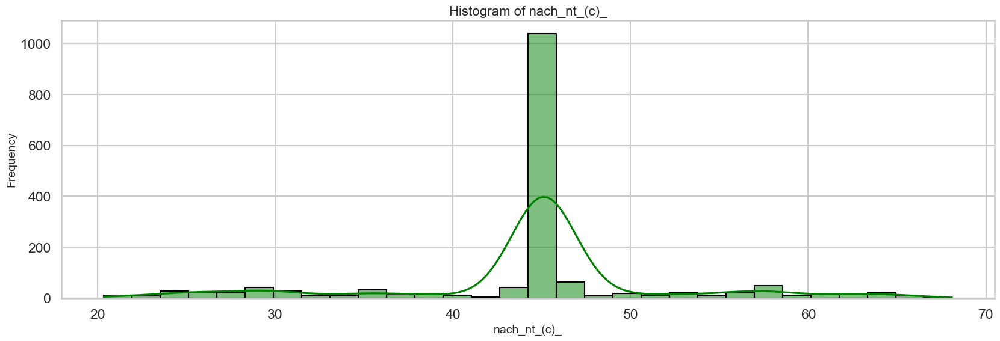

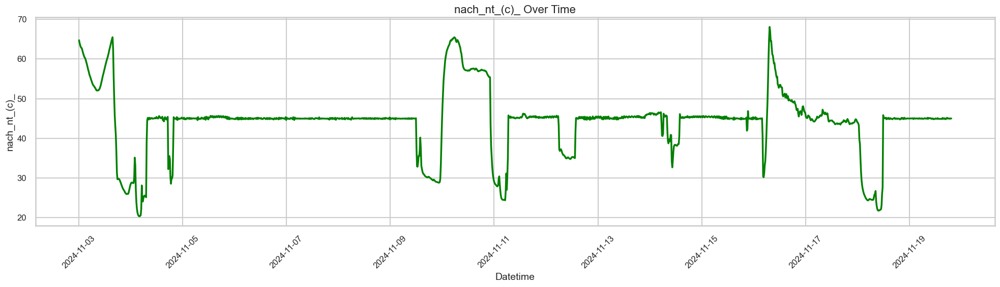

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: f10_speise_kg/h_


,count,mean,std,min,25%,50%,75%,max,unique
f10_speise_kg/h_,1614.0,1417.00742,2114.852134,-26.458802,0.0,0.0,4154.676406,6040.54904,564


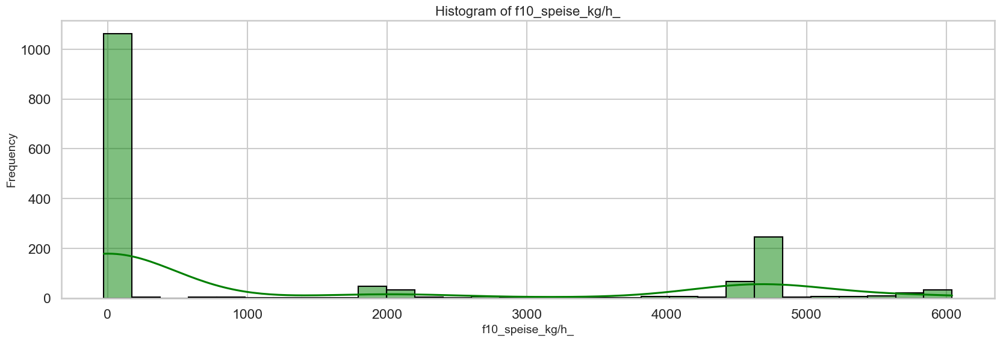

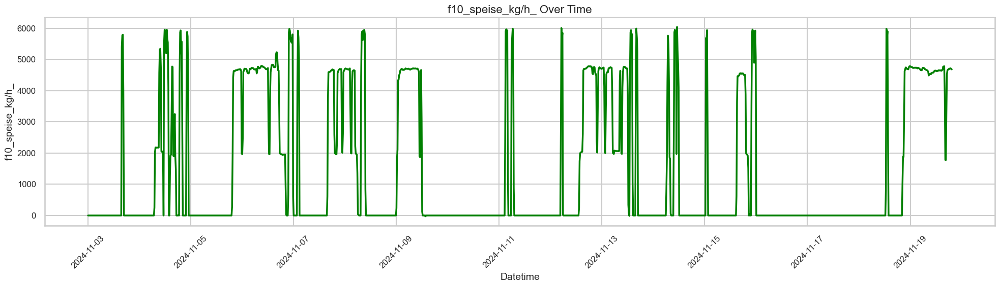

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: f11_speise_kg/h_


,count,mean,std,min,25%,50%,75%,max,unique
f11_speise_kg/h_,1614.0,1864.686715,2269.405307,-452.418568,0.0,0.0,4578.689707,6297.832791,743


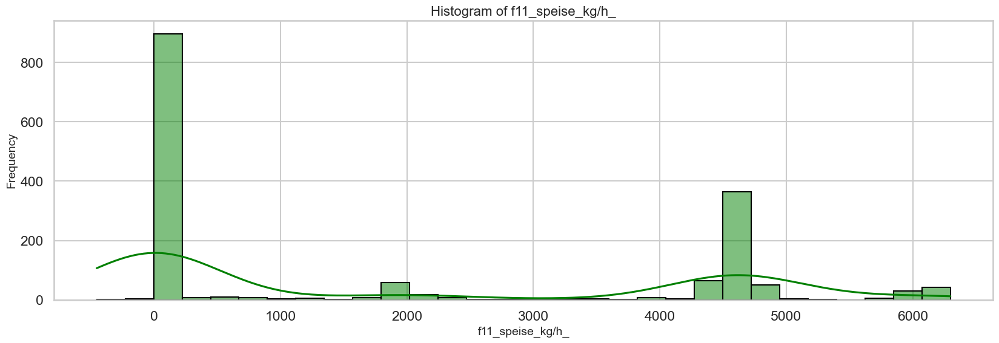

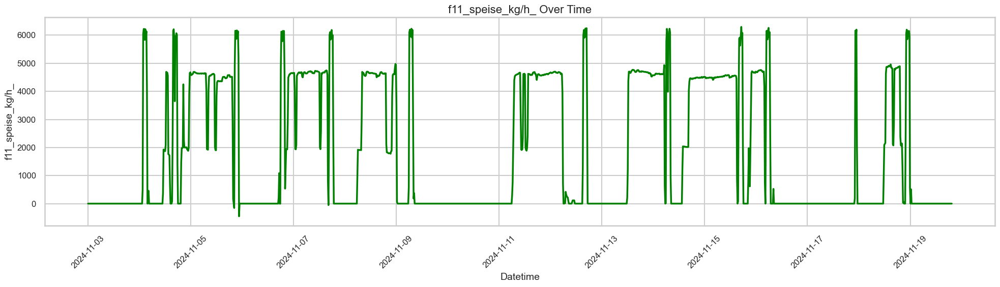

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: f10_speise_kg/m³_


,count,mean,std,min,25%,50%,75%,max,unique
f10_speise_kg/m³_,1614.0,0.47583,0.517853,0.0001,0.0001,0.000718,0.996025,1.13409,1196


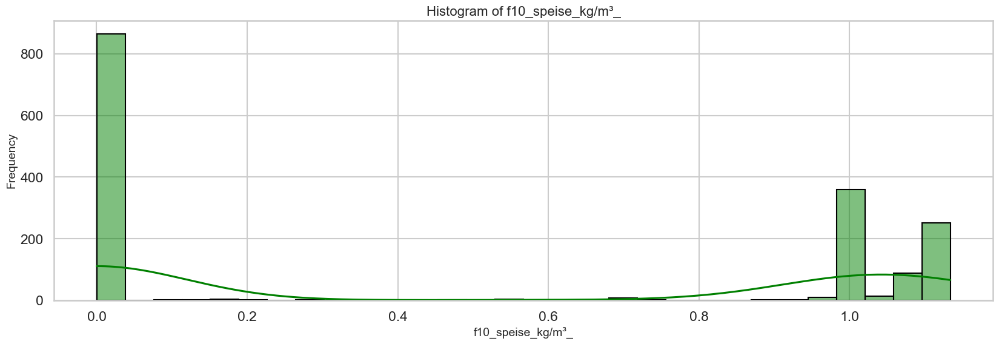

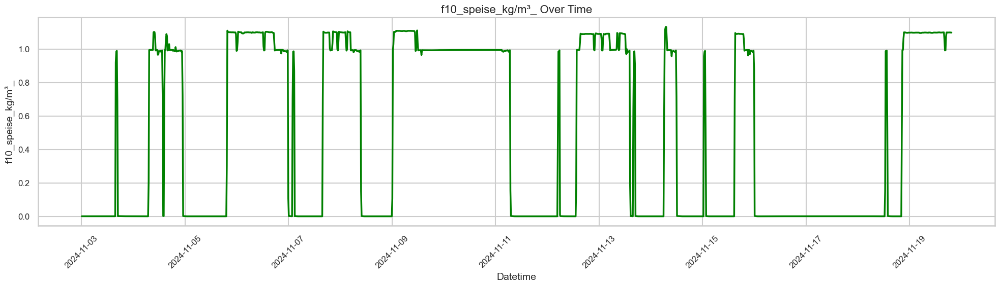

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: f11_speise_kg/m³_


,count,mean,std,min,25%,50%,75%,max,unique
f11_speise_kg/m³_,1614.0,0.515984,0.527806,0.0001,0.000223,0.001379,1.092463,1.113502,1314


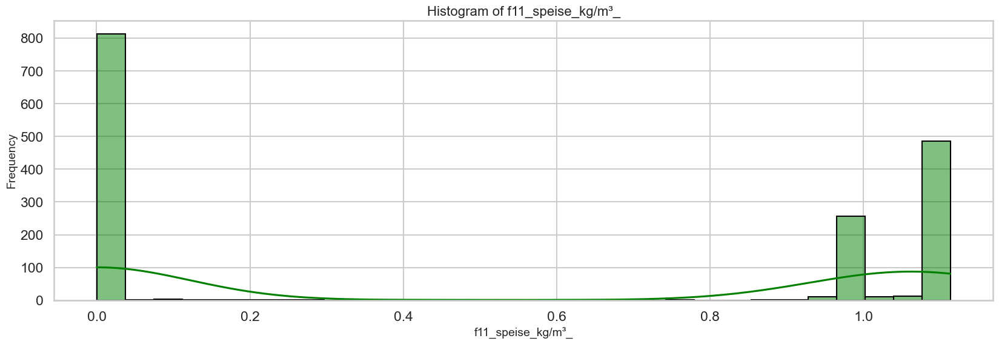

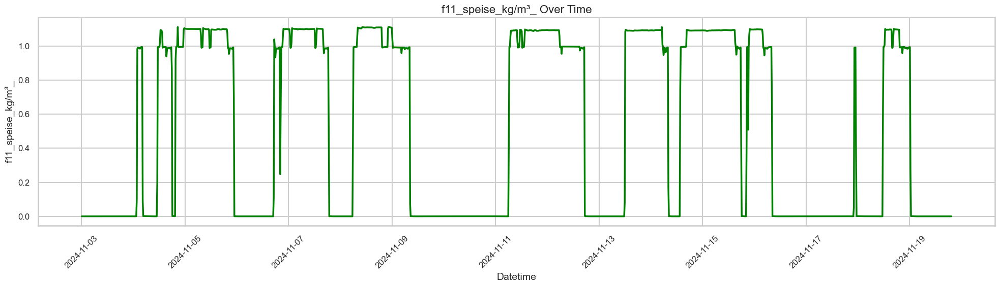

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: f10_speise_l/h_


,count,mean,std,min,25%,50%,75%,max,unique
f10_speise_l/h_,1614.0,1332.173629,1988.944161,-40.390133,0.0,0.0,3940.069796,6138.07417,564


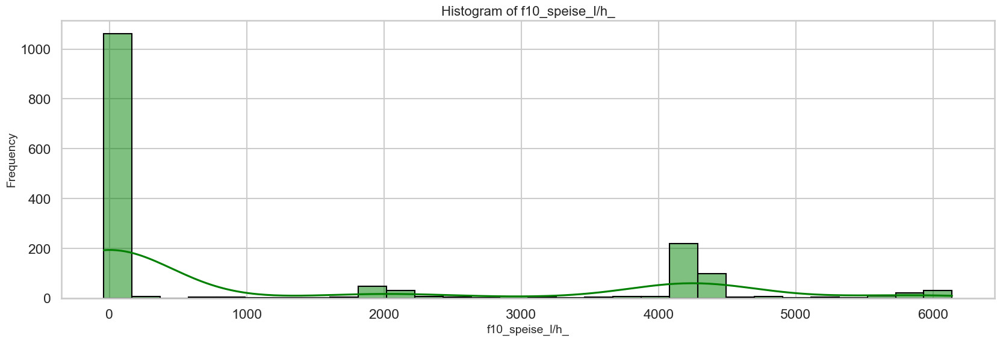

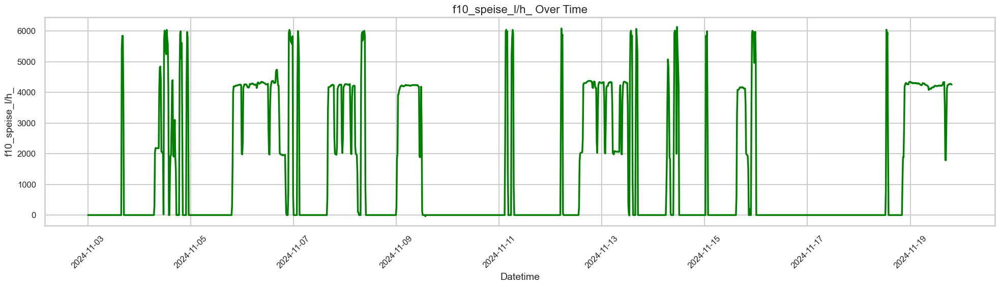

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: f11_speise_l/h_


,count,mean,std,min,25%,50%,75%,max,unique
f11_speise_l/h_,1614.0,1745.17267,2129.394637,-422.324291,0.0,0.0,4175.364284,6396.437522,743


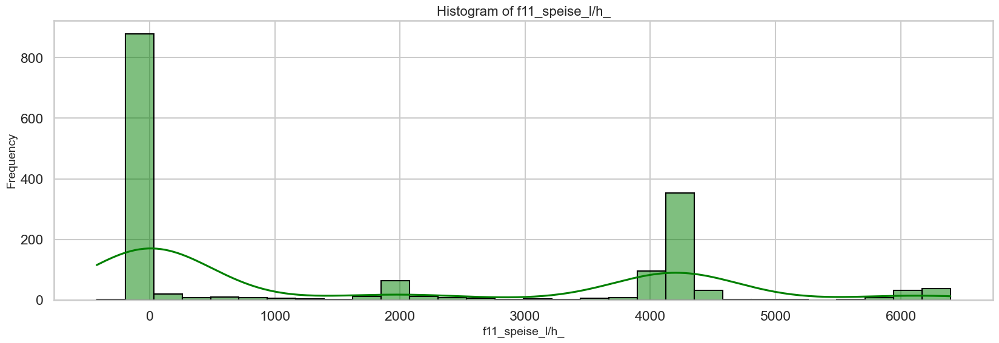

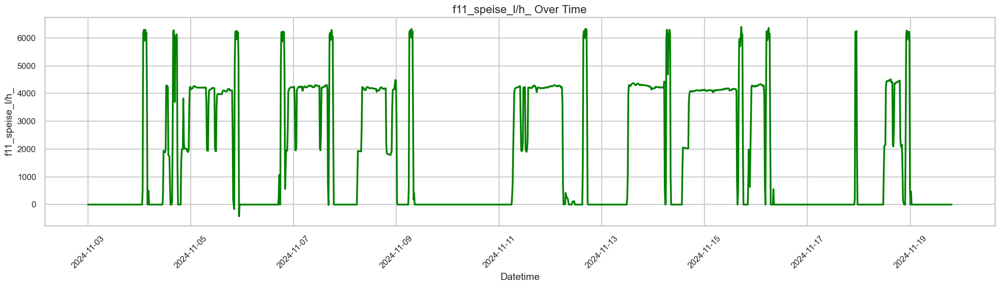

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (18)_leistung_turmF_lufterhitzer_kw


,count,mean,std,min,25%,50%,75%,max,unique
(18)_leistung_turmF_lufterhitzer_kw,1614.0,67.616806,95.103732,-0.064335,-0.00603,0.032165,119.4075,366.645,822


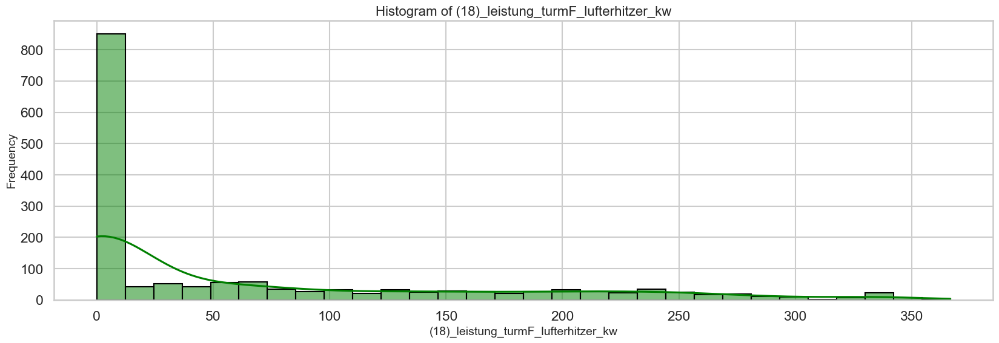

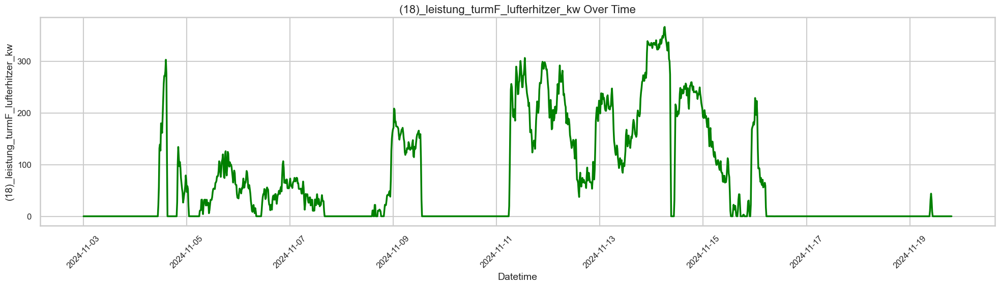

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (17)_leistung_turmF_luftentfeuchter_kw


,count,mean,std,min,25%,50%,75%,max,unique
(17)_leistung_turmF_luftentfeuchter_kw,1614.0,1310.488937,888.60793,-0.41816,38.0685,1910.325,1983.2375,2164.4,1522


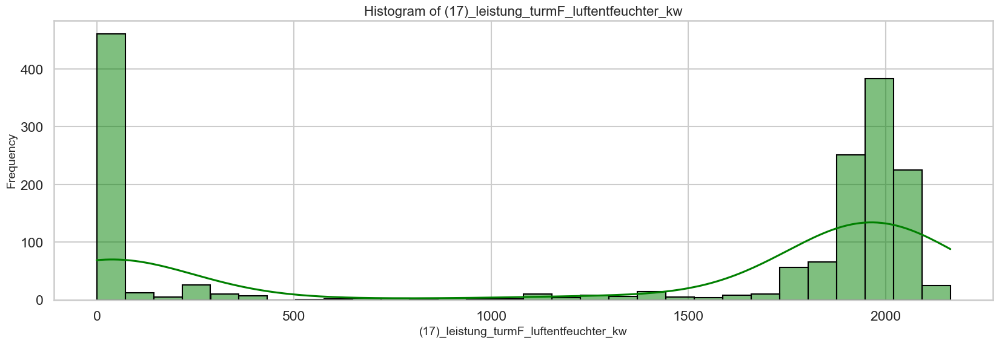

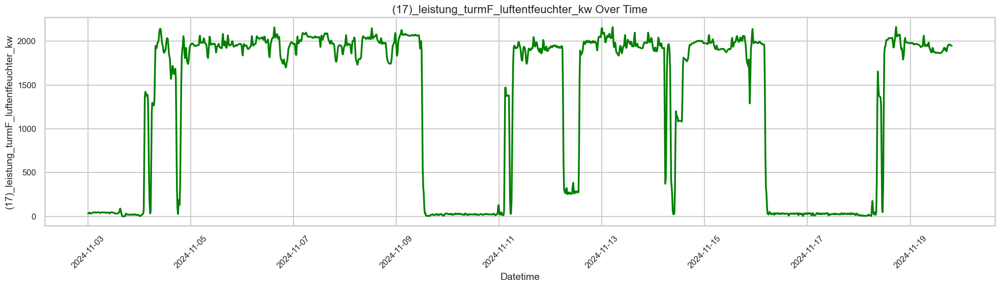

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (6)_nach_recu_reg_temp_c


,count,mean,std,min,25%,50%,75%,max,unique
(6)_nach_recu_reg_temp_c,1614.0,44.470938,7.88399,20.354299,44.861673,45.048545,45.438288,68.099924,1557


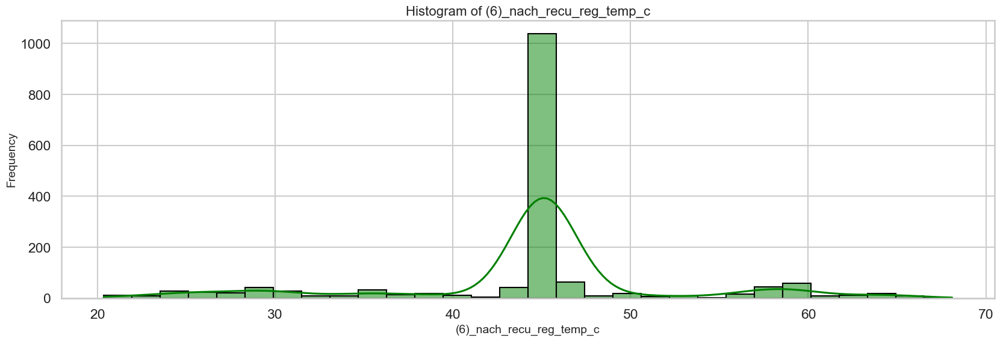

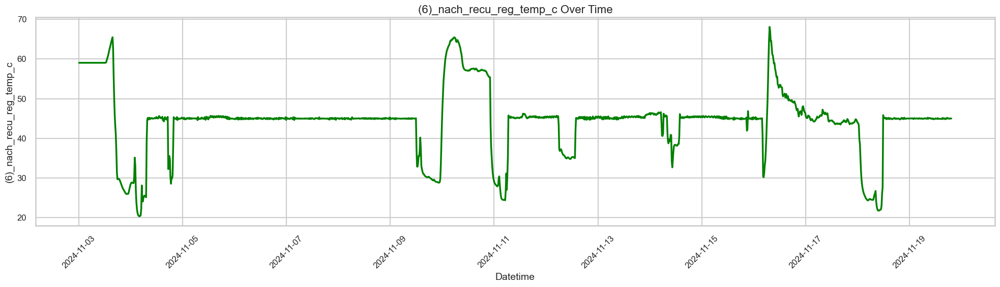

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (10)_abluft_temp_c


,count,mean,std,min,25%,50%,75%,max,unique
(10)_abluft_temp_c,1614.0,59.482656,18.5768,27.233537,37.718169,69.639003,73.542817,82.739056,1614


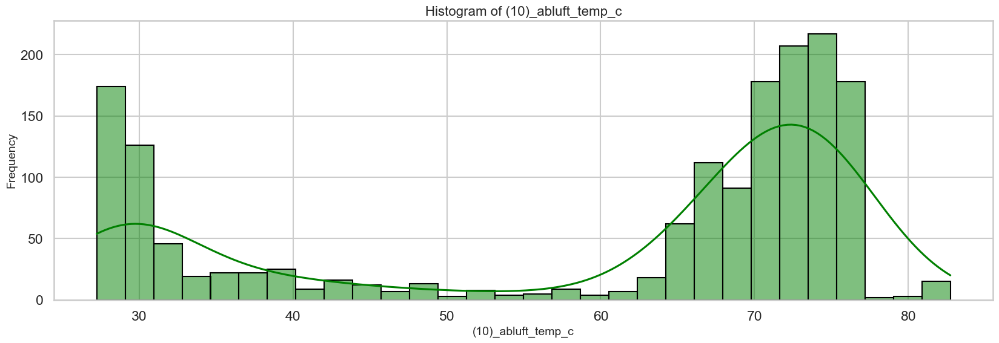

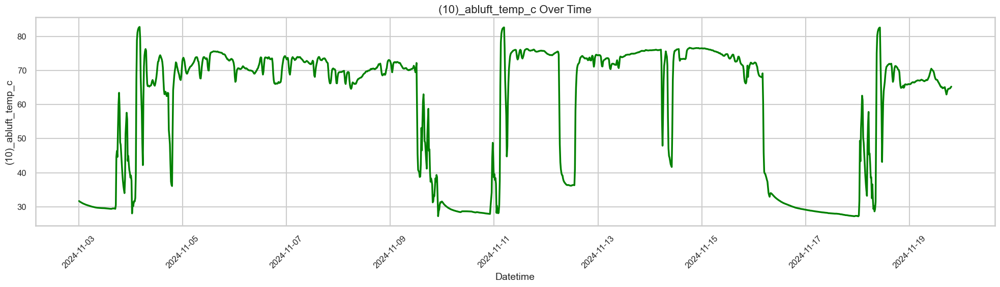

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (8)_abluft_mas_kg/h


,count,mean,std,min,25%,50%,75%,max,unique
(8)_abluft_mas_kg/h,1614.0,61399.648156,38813.083865,-0.413866,5295.45236,85598.254729,87635.549838,91831.661062,1614


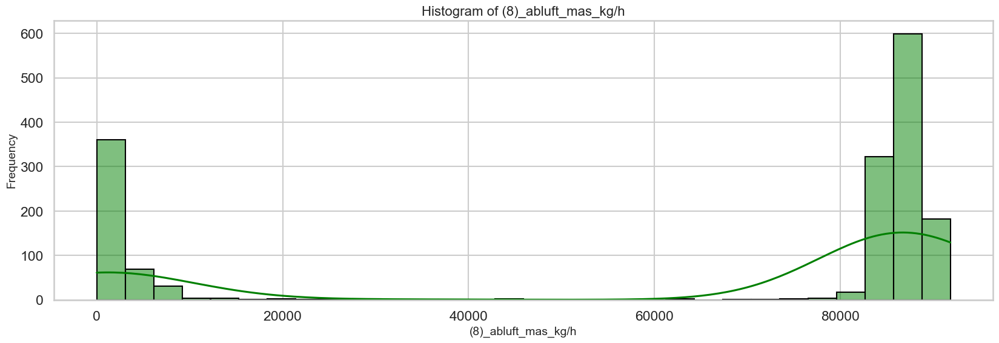

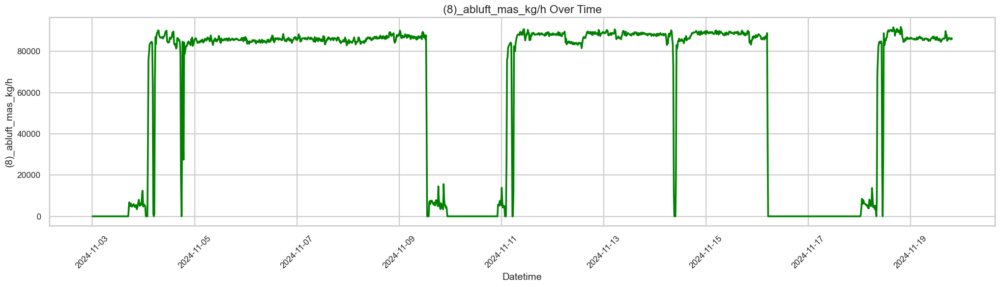

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: temperature_2m


,count,mean,std,min,25%,50%,75%,max,unique
temperature_2m,1614.0,6.27483,2.452536,0.034,4.684,6.634,7.834,11.884,178


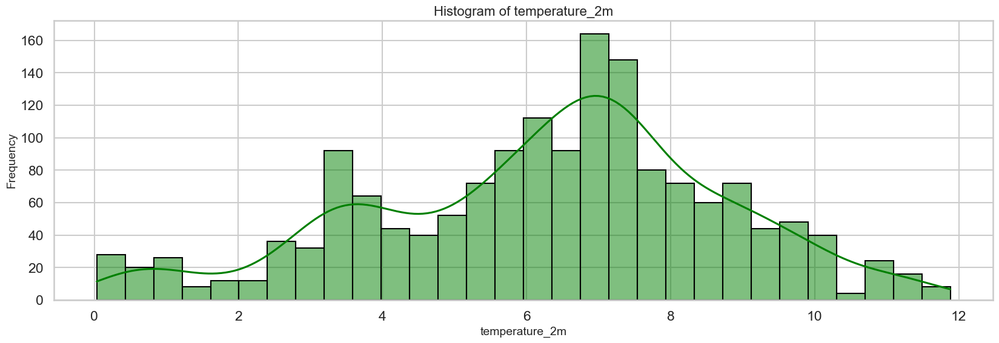

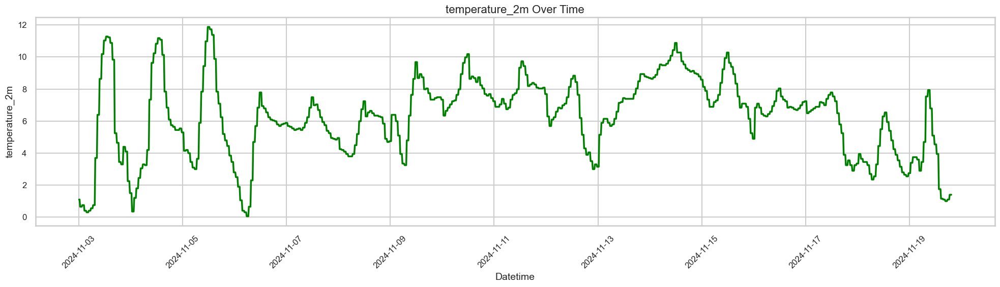

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: relative_humidity_2m


,count,mean,std,min,25%,50%,75%,max,unique
relative_humidity_2m,1614.0,90.289163,7.658621,69.49286,84.854515,92.66615,96.574739,100.0,383


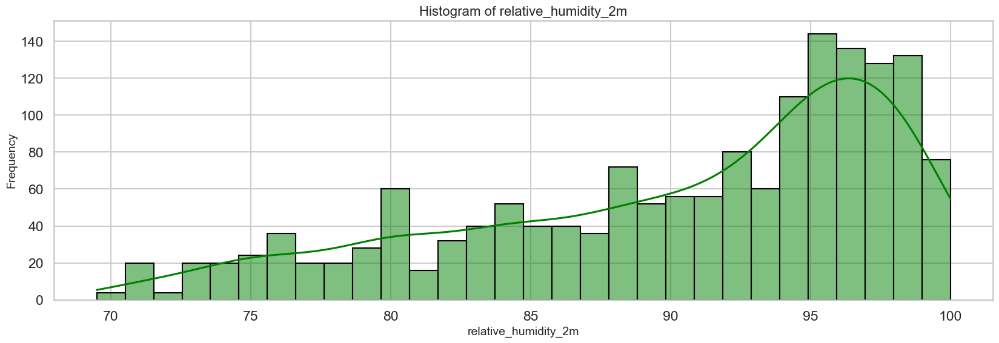

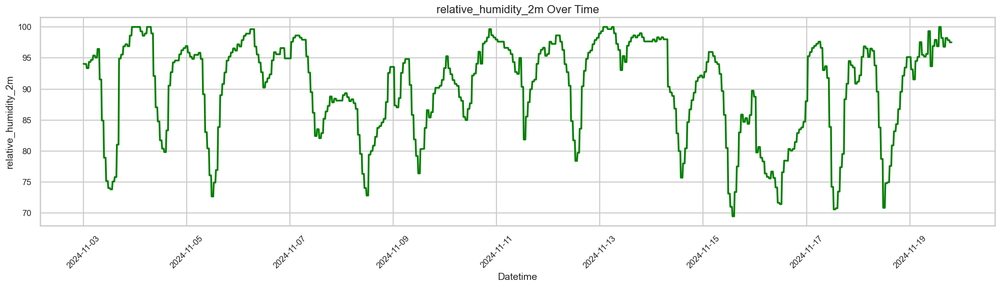

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: apparent_temperature


,count,mean,std,min,25%,50%,75%,max,unique
apparent_temperature,1614.0,3.521159,2.947632,-3.519549,1.634918,3.667877,5.73343,10.192743,404


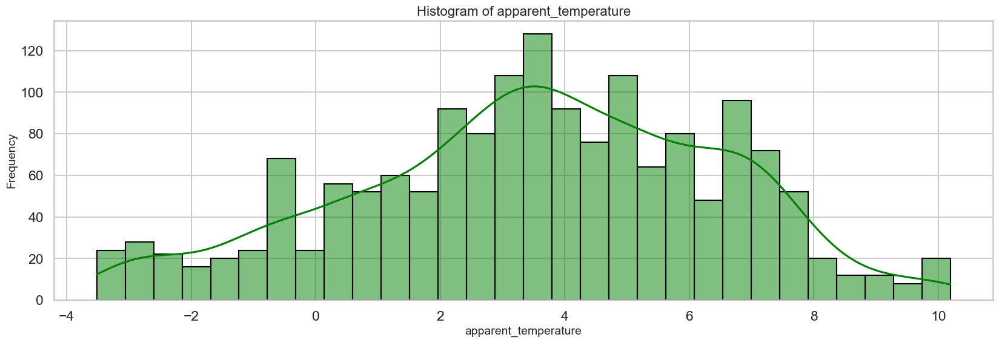

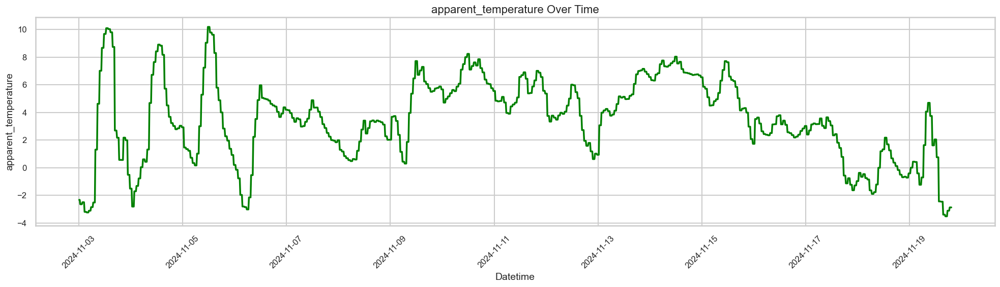

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: precipitation


,count,mean,std,min,25%,50%,75%,max,unique
precipitation,1614.0,0.12912,0.470171,0.0,0.0,0.0,0.0,4.0,22


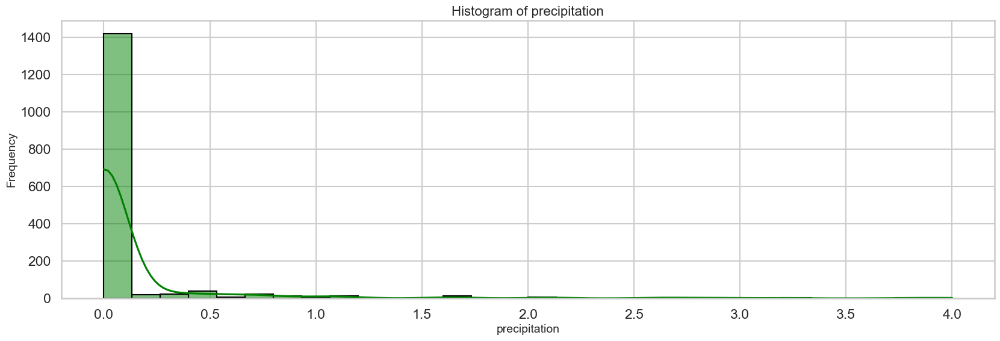

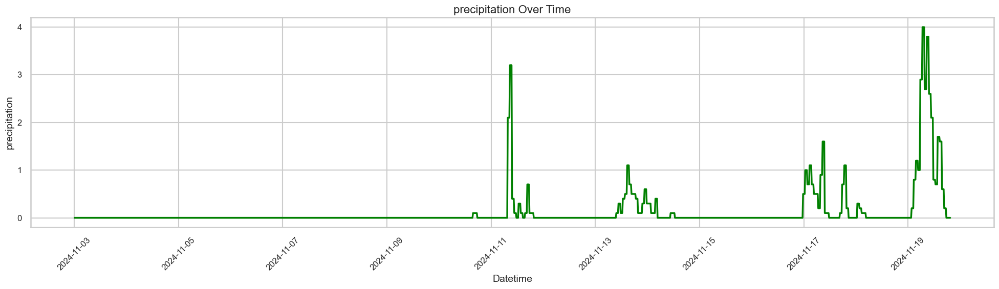

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: wind_speed_10m


,count,mean,std,min,25%,50%,75%,max,unique
wind_speed_10m,1614.0,10.368397,4.775028,1.70763,6.836438,9.505977,13.730531,23.940676,367


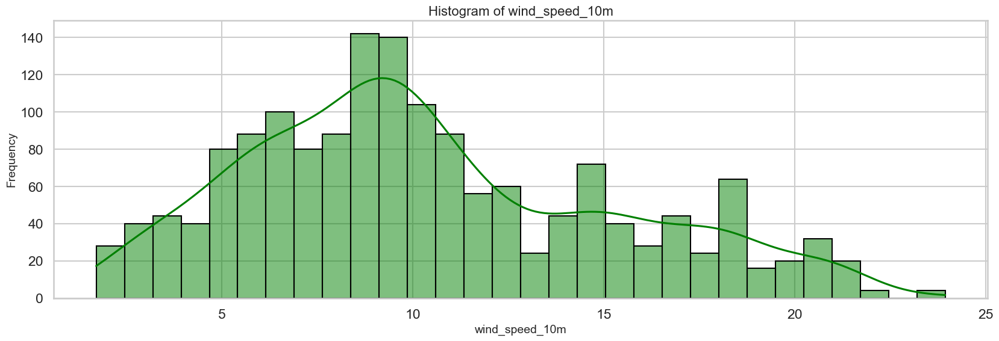

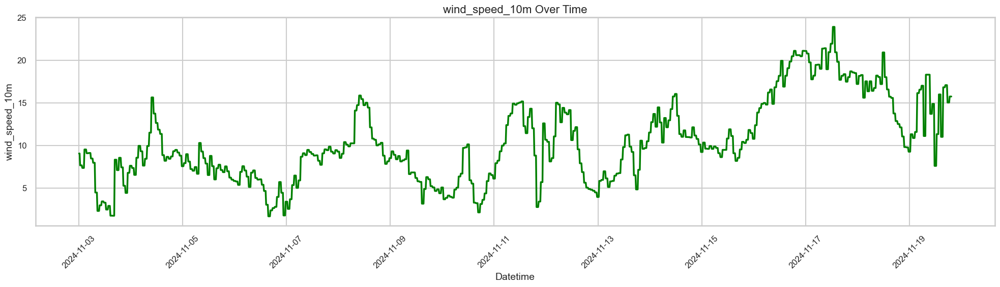

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: wind_direction_100m


,count,mean,std,min,25%,50%,75%,max,unique
wind_direction_100m,1614.0,190.66632,84.830348,15.524177,112.041345,220.87231,256.446428,360.0,398


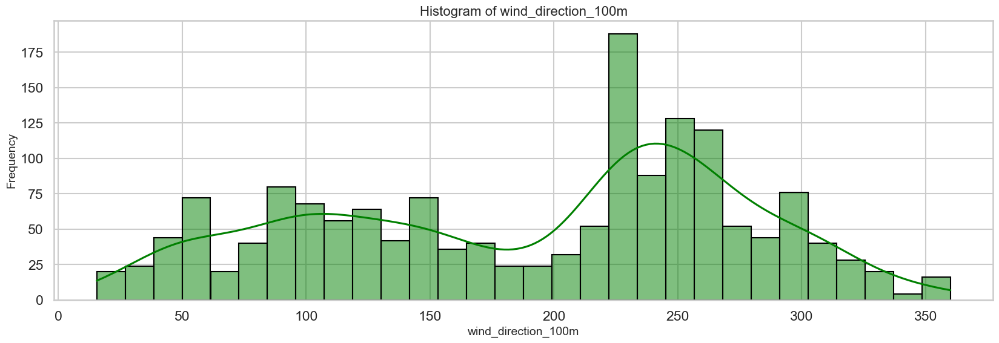

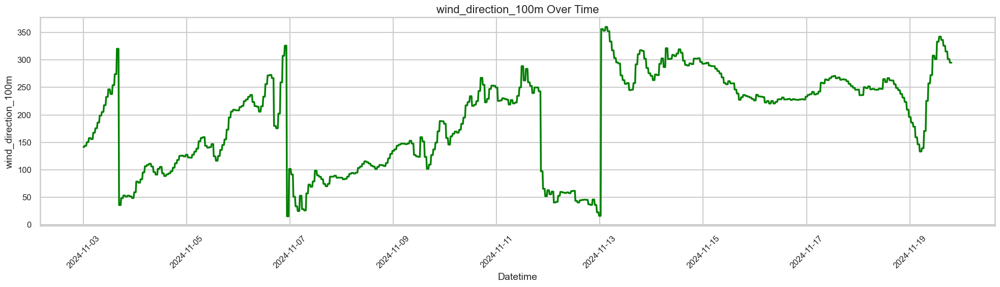

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: global_tilted_irradiance


,count,mean,std,min,25%,50%,75%,max,unique
global_tilted_irradiance,1614.0,40.024783,74.833342,0.0,0.0,0.0,43.75,360.00003,125


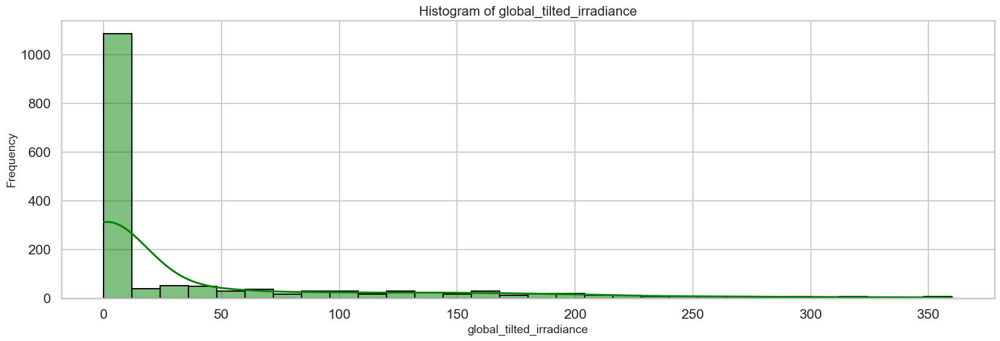

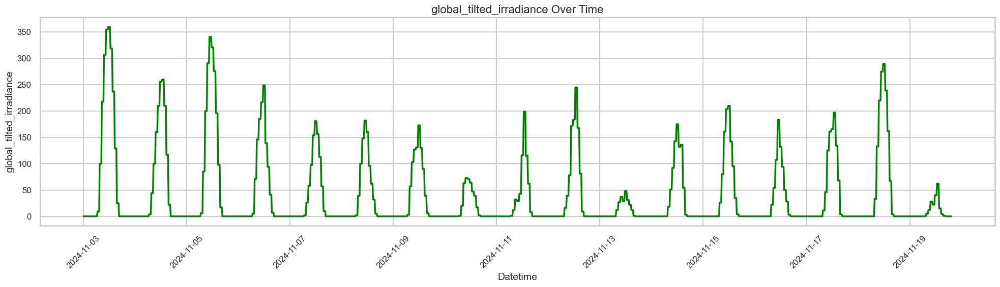

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (21)_zuluft_turm_mas_kg/h


,count,mean,std,min,25%,50%,75%,max,unique
(21)_zuluft_turm_mas_kg/h,1614.0,23753.412868,24442.370746,-15059.113228,-11228.384804,38280.108436,40897.876193,44837.807417,1614


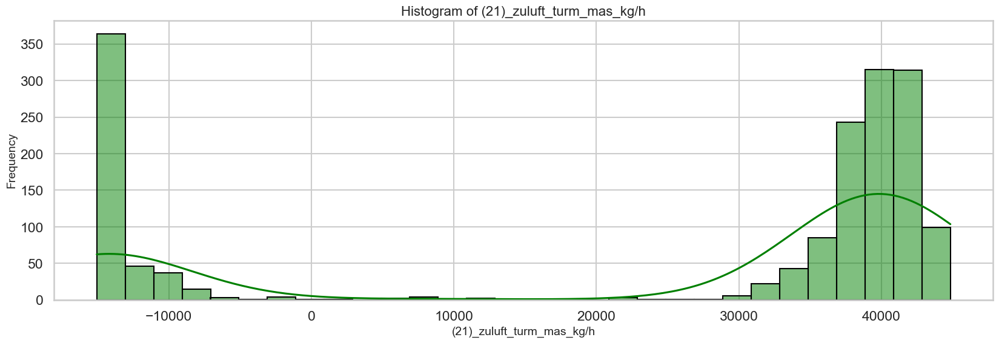

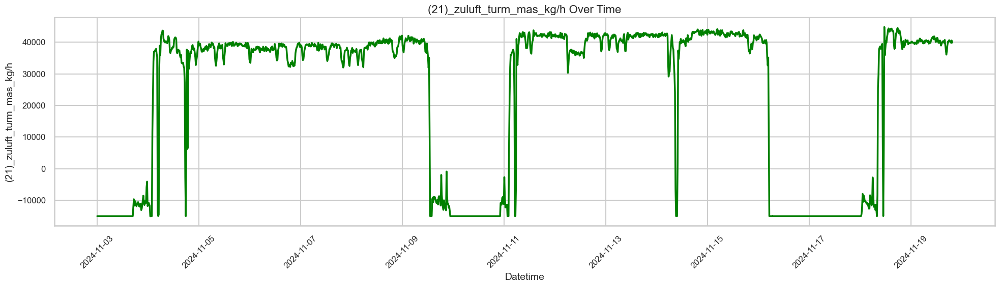

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (31)_q_waerme_recu_kw


,count,mean,std,min,25%,50%,75%,max,unique
(31)_q_waerme_recu_kw,1614.0,98.805747,109.931184,-174.791957,-6.632329,142.610347,181.646282,302.086917,1614


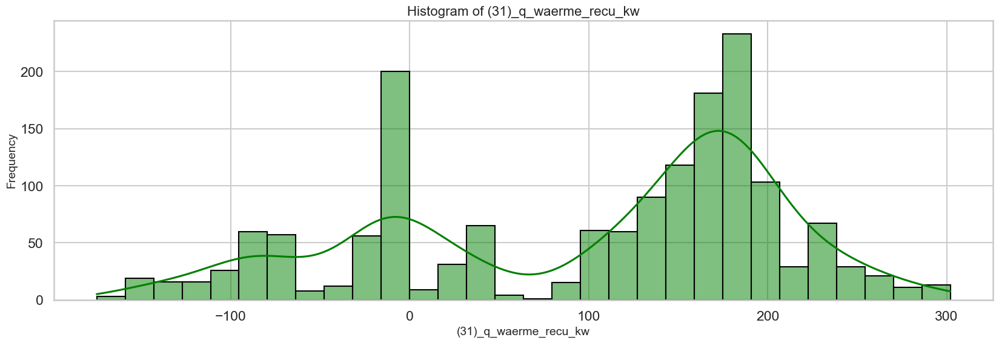

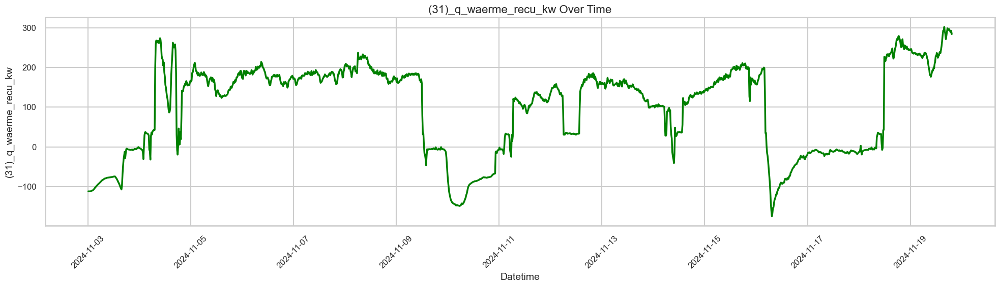

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (22)_t_waermereg_c


,count,mean,std,min,25%,50%,75%,max,unique
(22)_t_waermereg_c,1614.0,115.251197,119.956467,26.70413,68.707188,73.198893,76.105878,657.787026,1614


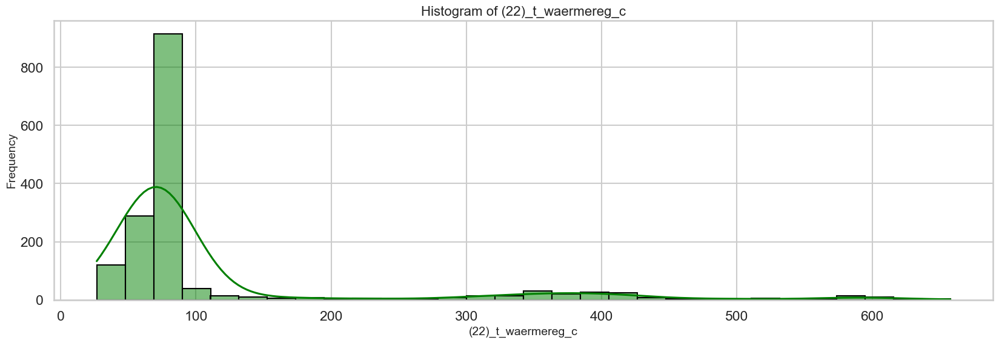

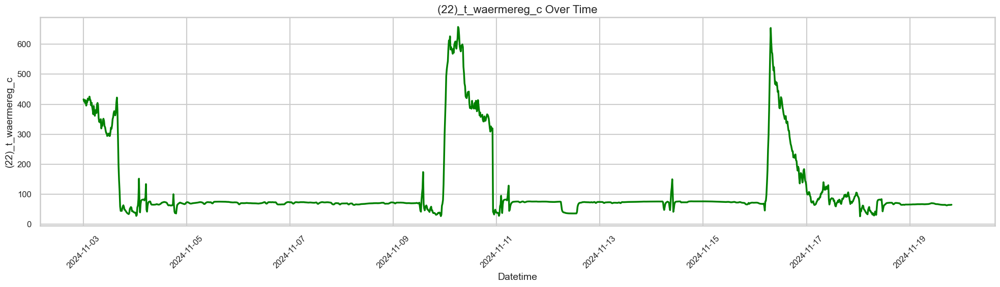

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (33)_q_lufterwearmung_dampgemessen_und_berechnete_recu_kw


,count,mean,std,min,25%,50%,75%,max,unique
(33)_q_lufterwearmung_dampgemessen_und_berechnete_recu_kw,1614.0,1409.294684,990.526854,-146.485457,16.597611,2060.800708,2165.073095,2423.721347,1614


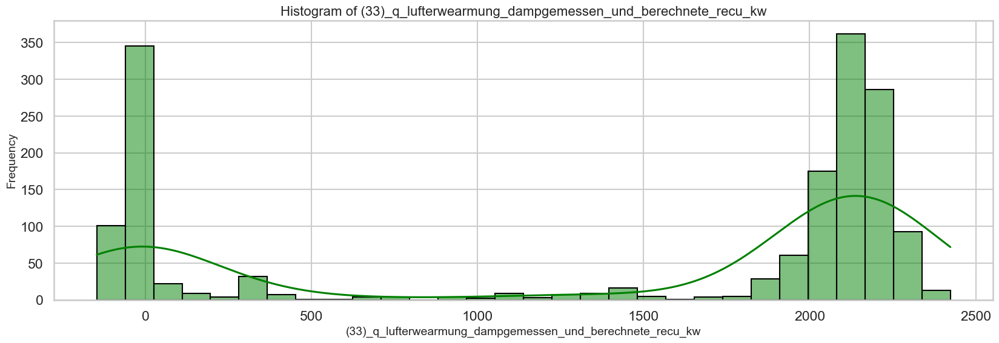

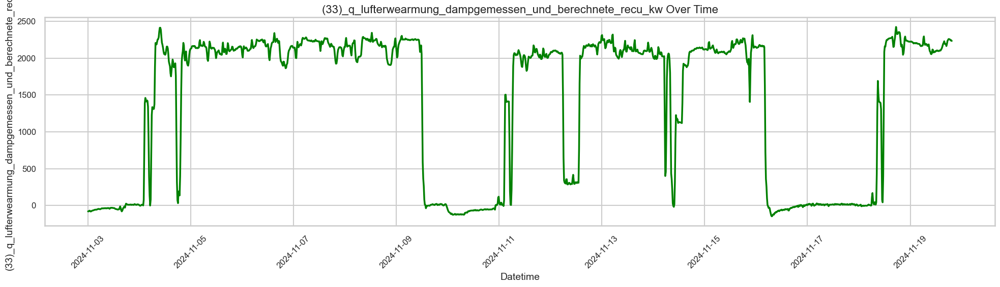

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (34)_q_lufterwearmung_berechnet_nach_temp_in_out_kw


,count,mean,std,min,25%,50%,75%,max,unique
(34)_q_lufterwearmung_berechnet_nach_temp_in_out_kw,1614.0,1058.048542,831.214171,-253.812488,-18.17235,1623.719429,1686.952748,1982.180964,1614


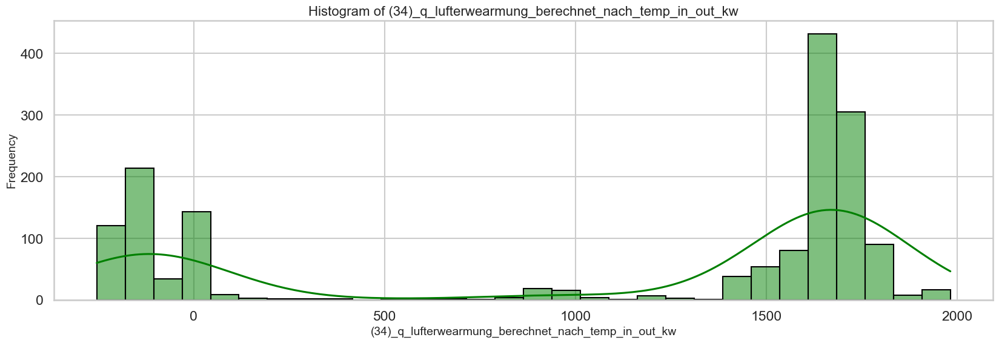

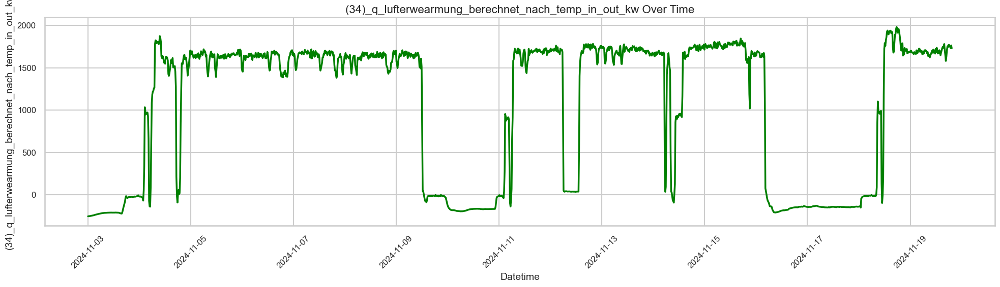

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: (1)_status


,count,mean,std,min,25%,50%,75%,max,unique
(1)_status,1614.0,37.608426,34.835265,0.0,0.0,70.0,70.0,110.0,8


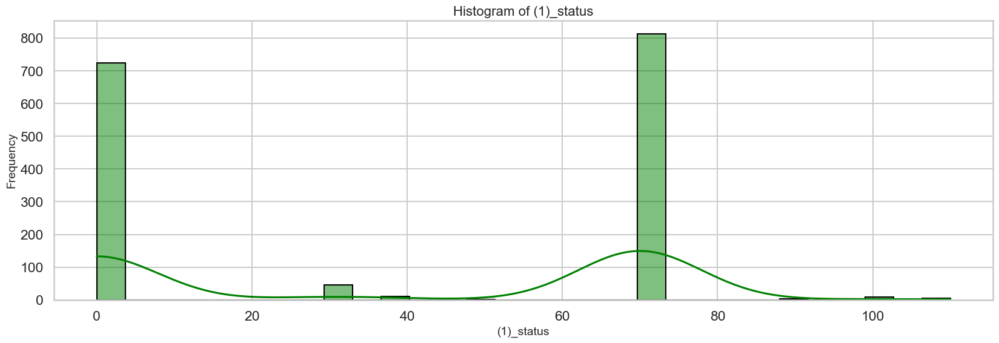

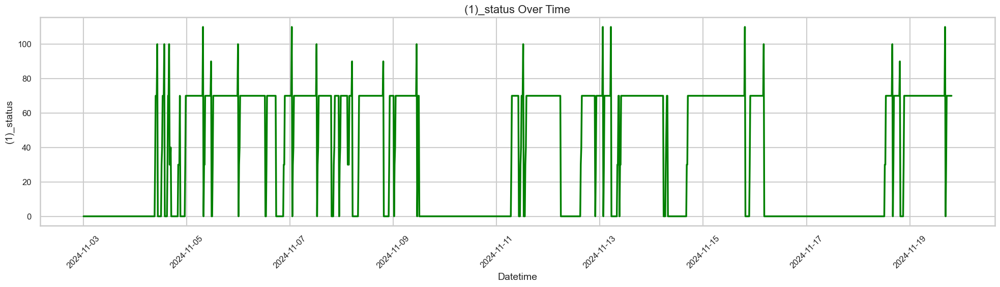

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: id_original


,count,mean,std,min,25%,50%,75%,max,unique
id_original,1614.0,8704.197646,2.979778,8701.0,8701.0,8707.0,8707.0,8710.0,8


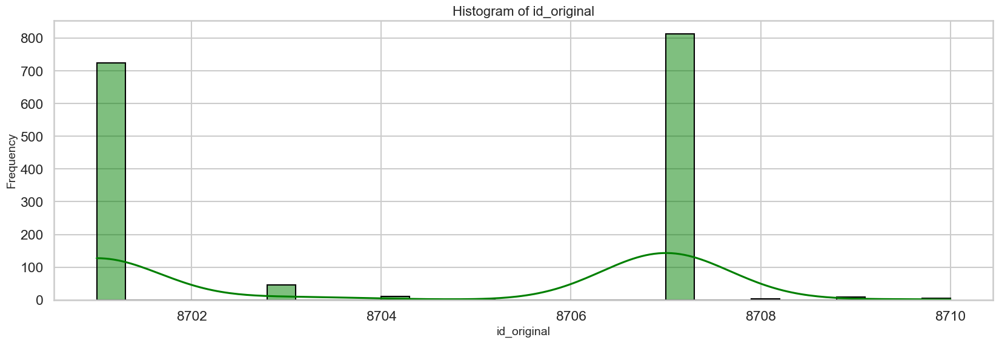

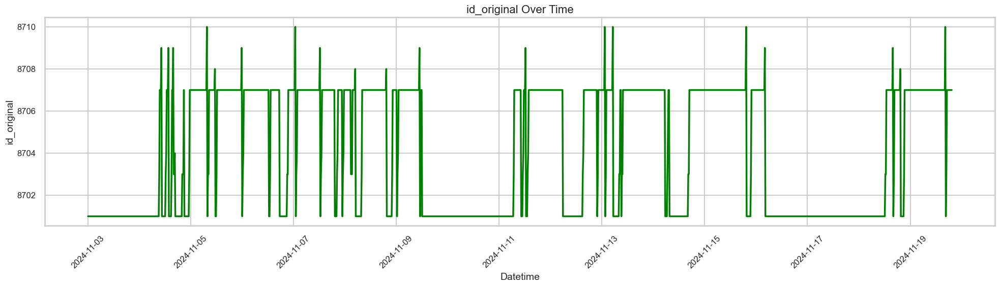

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Variable: status_name


,count,unique,top,freq
status_name,1614,8,Produktion,813


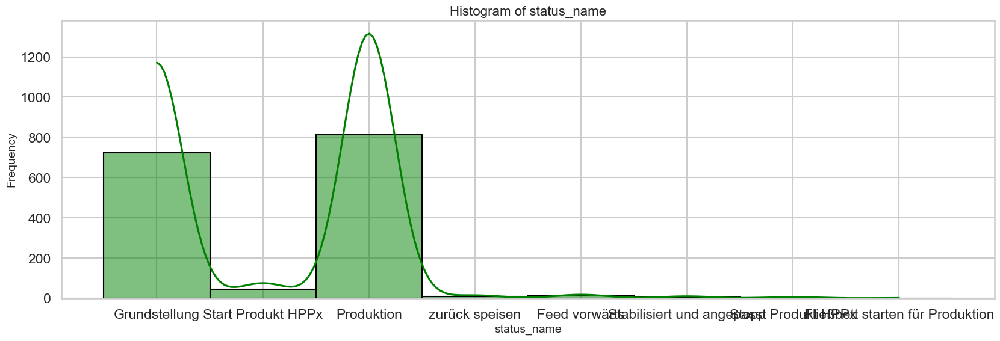

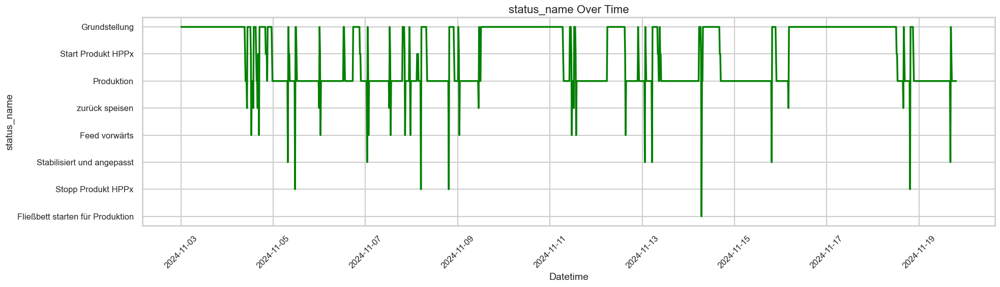

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


In [ ]:


pd.set_option('display.max_rows', 10)
# Display the resampled DataFrame
display(df_resampled_1_min)
visualize_data(df_resampled_1_min, datetime_col="datetime", library="seaborn")

- [Index](#Index)

In [ ]:
# Petri net

# df = df_resampled_1H[['datetime','status_name_l01']].reset_index()

# df['index'] = 1

# df = df[['datetime','status_name_l01', 'index']]

# df.columns = ['timestamp' , 'activity', 'case_id']

# event_log = pm4py.format_dataframe(df, case_id='case_id', activity_key='activity', timestamp_key='timestamp')

# #process_tree = pm4py.discover_process_tree_inductive(event_log)

# net2, im2, fm2 = pm4py.discover_petri_net_inductive(event_log)
# #net2, im2, fm2 = pm4py.discover_petri_net_alpha(event_log)
# pm4py.view_petri_net(net2, im2, fm2)

In [ ]:
# import pm4py
# import pandas as pd

# # Example dataframe
# process_df = df_resampled_1H[['datetime', 'status_name_l01']].reset_index()

# process_df['index'] = 1  # Add a case ID

# # Format the dataframe for PM4Py
# event_log = pm4py.format_dataframe(process_df, case_id='index', activity_key='status_name_l01', timestamp_key='datetime')

# # Discover the Directly-Follows Graph (DFG)
# dfg, start_activities, end_activities = pm4py.discover_dfg(event_log)

# # Visualize the Directly-Follows Graph (DFG)
# pm4py.view_dfg(dfg, start_activities, end_activities)

# # Now, let's convert this DFG into a Petri net
# # Discover the Petri net using the Alpha Miner
# net, initial_marking, final_marking = pm4py.algo.discovery.alpha.apply(event_log)

# # Visualize the Petri net (states as circles)
# parameters = {pm4py.visualization.petri_net.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"}
# gviz = pm4py.visualization.petri_net.apply(net, initial_marking, final_marking, parameters=parameters)

# # View the Petri net
# pm4py.visualization.petri_net.view(gviz)

In [ ]:
# import pm4py
# import pandas as pd

# process_df = df_resampled_1H[['datetime','status_name_l01']].reset_index()

# process_df['index'] = 1

# # Format the dataframe for PM4Py
# event_log = pm4py.format_dataframe(process_df, case_id='index', activity_key='status_name_l01', timestamp_key='datetime')

# # Discover the Directly-Follow Graph (DFG)
# dfg, start_activities, end_activities = pm4py.discover_dfg(event_log)

# # Filter out transitions where the source and target are the same
# dfg_filtered = {key: value for key, value in dfg.items() if key[0] != key[1]}

# # View the filtered DFG
# pm4py.view_dfg(dfg_filtered, start_activities, end_activities)

In [ ]:
# import pandas as pd
# from pm4py.objects.conversion.log import converter as log_converter
# from pm4py.algo.discovery.alpha import algorithm as alpha_miner
# from pm4py.visualization.petri_net import visualizer as pn_visualizer
# from pm4py.visualization.petri_net.util import performance_map

# # Example DataFrame (replace with your data)
# data = {
#     'status_name_l01': ['A', 'B', 'A', 'C', 'B', 'A'],
#     'next_state': ['B', 'A', 'C', 'B', 'A', 'B'],
#     'count': [3, 2, 1, 5, 4, 3]  # Replace with your calculated counts
# }

# # Convert data into an event log format
# log_data = []
# for status_name_l01, next_state, count in zip(data['status_name_l01'], data['next_state'], data['count']):
#     for _ in range(count):  # Repeating the transition based on count
#         log_data.append([status_name_l01, next_state])

# # Create a DataFrame for the event log
# log_df = pd.DataFrame(log_data, columns=["concept:name", "next_state"])

# # Convert the DataFrame to an event log
# log = log_converter.apply(log_df)

# # Apply Alpha Miner to discover the Petri net
# net, initial_marking, final_marking = alpha_miner.apply(log)

# # Visualize the Petri net
# parameters = {pn_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"}
# gviz = pn_visualizer.apply(net, initial_marking, final_marking, parameters=parameters)
# pn_visualizer.view(gviz)

In [ ]:
# import pandas as pd
# from pm4py.objects.conversion.log import converter as log_converter
# from pm4py.algo.discovery.alpha import algorithm as alpha_miner
# from pm4py.visualization.petri_net import visualizer as pn_visualizer

# data = transition_counts

# # Convert data into an event log format
# log_data = []
# case_id = 1  # Start with a case ID

# for status_name_l01, next_state, count in zip(data['status_name_l01'], data['next_state'], data['count']):
#     for _ in range(count):  # Repeating the transition based on count
#         log_data.append([case_id, status_name_l01, next_state])  # Add case ID
#     case_id += 1  # Increment case ID for each unique case

# # Create a DataFrame for the event log
# log_df = pd.DataFrame(log_data, columns=["case:concept:name", "concept:name", "next_state"])

# # Convert the DataFrame to an event log
# log = log_converter.apply(log_df)

# # Apply Alpha Miner to discover the Petri net
# net, initial_marking, final_marking = alpha_miner.apply(log)

# # Visualize the Petri net
# parameters = {pn_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"}
# gviz = pn_visualizer.apply(net, initial_marking, final_marking, parameters=parameters)
# pn_visualizer.view(gviz)

In [ ]:
# import pandas as pd
# from pm4py.objects.conversion.log import converter as log_converter
# from pm4py.algo.discovery.alpha import algorithm as alpha_miner
# from pm4py.visualization.petri_net import visualizer as pn_visualizer

# # Example DataFrame (replace with your data)
# data = {
#     'status_name_l01': ['A', 'B', 'A', 'C', 'B', 'A'],
#     'next_state': ['B', 'A', 'C', 'B', 'A', 'B'],
#     'count': [3, 2, 1, 5, 4, 3]  # Replace with your calculated counts
# }

# # Convert data into an event log format
# log_data = []
# case_id = 1  # Start with a case ID

# for status_name_l01, next_state, count in zip(data['status_name_l01'], data['next_state'], data['count']):
#     for _ in range(count):  # Repeating the transition based on count
#         log_data.append([case_id, status_name_l01, next_state])  # Add case ID
#     case_id += 1  # Increment case ID for each unique case

# # Create a DataFrame for the event log
# log_df = pd.DataFrame(log_data, columns=["case:concept:name", "concept:name", "next_state"])

# # Convert the DataFrame to an event log
# log = log_converter.apply(log_df)

# # Apply Alpha Miner to discover the Petri net
# net, initial_marking, final_marking = alpha_miner.apply(log)

# # Visualize the Petri net
# parameters = {pn_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"}
# gviz = pn_visualizer.apply(net, initial_marking, final_marking, parameters=parameters)
# pn_visualizer.view(gviz)

In [ ]:
# import pandas as pd
# from pm4py.objects.conversion.log import converter as log_converter
# from pm4py.algo.discovery.alpha import algorithm as alpha_miner
# from pm4py.visualization.petri_net import visualizer as pn_visualizer

# # Example DataFrame (replace with your data)
# data = {
#     'status_name_l01': ['A', 'B', 'A', 'C', 'B', 'A'],
#     'next_state': ['B', 'A', 'C', 'B', 'A', 'B'],
#     'count': [3, 2, 1, 5, 4, 3]  # Replace with your calculated counts
# }

# # data = transition_counts

# # Convert data into an event log format
# log_data = []

# # Create one case for each flow of transitions
# for case_id, (status_name_l01, next_state, count) in enumerate(zip(data['status_name_l01'], data['next_state'], data['count']), 1):
#     # Add events based on the count
#     for _ in range(count):
#         log_data.append([case_id, status_name_l01])  # Start state for the case
#         log_data.append([case_id, next_state])  # Next state for the case

# # Create a DataFrame for the event log
# log_df = pd.DataFrame(log_data, columns=["case:concept:name", "concept:name"])

# # Convert the DataFrame to an event log
# log = log_converter.apply(log_df)

# # Apply Alpha Miner to discover the Petri net
# net, initial_marking, final_marking = alpha_miner.apply(log)

# # Visualize the Petri net
# parameters = {pn_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"}
# gviz = pn_visualizer.apply(net, initial_marking, final_marking, parameters=parameters)
# pn_visualizer.view(gviz)

- [Index](#Index)